In [1]:
%matplotlib inline

In [2]:
from datetime import datetime
import os
from os.path import dirname, abspath, join
from os import getcwd
import sys

In [3]:
import random
import string
import pandas as pd
import numpy as np

In [4]:
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker

In [5]:
import torch
import socket
from IPython.display import clear_output

In [6]:
# seed_arg = int(sys.argv[1])
# print ("\n\nSeed ARG: ",seed_arg)
seed_arg = 1

In [7]:
seedlist = np.array([161, 314, 228, 271828, 230, 4271031, 5526538, 6610165, 9849252, 34534, 73422, 8765])
seed = seedlist[seed_arg]
random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)
np.random.seed(seed)
os.environ['PYTHONHASHSEED'] = str(seed)

In [8]:
NAME       = 'B1_2_wakkanai_alt_100w'
MODELNAME  = NAME + '_' + str(seed) + '.pt'
print("\nMODEL : ", NAME)
print("SEED  : ",seed_arg)
print("HOST  : ",socket.gethostname())
print("START : ",datetime.now())


MODEL :  B1_2_wakkanai_alt_100w
SEED  :  1
HOST  :  e5155838fc98
START :  2019-03-17 21:36:55.356420


In [9]:
class ENO(object):
    
    #no. of forecast types is 6 ranging from 0 to 5
  
    def __init__(self, location='tokyo', year=2010, shuffle=False, day_balance=False):
        self.location = location
        self.year = year
        self.day = None
        self.hr = None
        
        self.shuffle = shuffle
        self.day_balance = day_balance

        self.TIME_STEPS = None #no. of time steps in one episode
        self.NO_OF_DAYS = None #no. of days in one year
        
        self.NO_OF_DAYTYPE = 10 #no. of daytypes
        self.daycounter = 0 #to count number of days that have been passed
        
        self.sradiation = None #matrix with GSR for the entire year
        self.senergy = None #matrix with harvested energy data for the entire year
        self.fforecast = None #array with forecast values for each day
        

        self.henergy = None #harvested energy variable
        self.fcast = None #forecast variable
        self.sorted_days = [] #days sorted according to day type
        
        self.SMAX = 1000 # 1 Watt Solar Panel

    
    #function to get the solar data for the given location and year and prep it
    def get_data(self):
        #solar_data/CSV files contain the values of GSR (Global Solar Radiation in MegaJoules per meters squared per hour)
        #weather_data/CSV files contain the weather summary from 06:00 to 18:00 and 18:00 to 06:00+1
        location = self.location
        year = self.year

        THIS_DIR = getcwd()
        SDATA_DIR = abspath(join(THIS_DIR, 'solar_data'))  #abspath(join(THIS_DIR, '../../..', 'data'))
        
        sfile = SDATA_DIR + '/' + location +'/' + str(year) + '.csv'
        
        #skiprows=4 to remove unnecessary title texts
        #usecols=4 to read only the Global Solar Radiation (GSR) values
        solar_radiation = pd.read_csv(sfile, skiprows=4, encoding='shift_jisx0213', usecols=[4])
      
        #convert dataframe to numpy array
        solar_radiation = solar_radiation.values

        #convert missing data in CSV files to zero
        solar_radiation[np.isnan(solar_radiation)] = 0

        #reshape solar_radiation into no_of_daysx24 array
        solar_radiation = solar_radiation.reshape(-1,24)

        if(self.shuffle): #if class instatiation calls for shuffling the day order. Required when learning
            np.random.shuffle(solar_radiation) 
        self.sradiation = solar_radiation
        
        #GSR values (in MJ/sq.mts per hour) need to be expressed in mW
        # Conversion is accomplished by 
        # solar_energy = GSR(in MJ/m2/hr) * 1e6 * size of solar cell * efficiency of solar cell /(60x60) *1000 (to express in mW)
        # the factor of 2 in the end is assuming two solar cells
        self.senergy = 2*self.sradiation * 1e6 * (55e-3 * 70e-3) * 0.15 * 1000/(60*60)

        return 0
    
    #function to map total day radiation into type of day ranging from 0 to 5
    #the classification into day types is quite arbitrary. There is no solid logic behind this type of classification.
    
    def get_day_state(self,tot_day_radiation):
        bin_edges = np.array([0, 3.5, 6.5, 9.0, 12.5, 15.5, 18.5, 22.0, 25, 28])
        for k in np.arange(1,bin_edges.size):
            if (bin_edges[k-1] < tot_day_radiation <= bin_edges[k]):
                day_state = k -1
            else:
                day_state = bin_edges.size - 1
        return int(day_state)
    
    def get_forecast(self):
        #create a perfect forecaster.
        tot_day_radiation = np.sum(self.sradiation, axis=1) #contains total solar radiation for each day
        get_day_state = np.vectorize(self.get_day_state)
        self.fforecast = get_day_state(tot_day_radiation)
        
        #sort days depending on the type of day and shuffle them; maybe required when learning
        for fcast in range(0,6):
            fcast_days = ([i for i,x in enumerate(self.fforecast) if x == fcast])
            np.random.shuffle(fcast_days)
            self.sorted_days.append(fcast_days)
        return 0
    
    def reset(self,day=0): #it is possible to reset to the beginning of a certain day
        
        self.get_data() #first get data for the given year
        self.get_forecast() #calculate the forecast
        
        self.TIME_STEPS = self.senergy.shape[1]
        self.NO_OF_DAYS = self.senergy.shape[0]
        
        self.day = day
        self.hr = 0
        
        self.henergy = self.senergy[self.day][self.hr]
        self.fcast = self.fforecast[self.day]
        
        end_of_day = False
        end_of_year = False
        return [self.henergy, self.fcast, end_of_day, end_of_year]

    
    def step(self):
        end_of_day = False
        end_of_year = False
        if not(self.day_balance): #if daytype balance is not required
            if(self.hr < self.TIME_STEPS - 1):
                self.hr += 1
                self.henergy = self.senergy[self.day][self.hr] 
                self.fcast = self.fforecast[self.day]
            else:
                if(self.day < self.NO_OF_DAYS -1):
                    end_of_day = True
                    self.hr = 0
                    self.day += 1
                    self.henergy = self.senergy[self.day][self.hr] 
                    self.fcast = self.fforecast[self.day]
                else:
                    end_of_day = True
                    end_of_year = True
                    
        else: #when training, we want all daytypes to be equally represented for robust policy
              #obviously, the days are going to be in random order
            if(self.hr < self.TIME_STEPS - 1):
                self.hr += 1
                self.henergy = self.senergy[self.day][self.hr]
                self.fcast = self.fforecast[self.day]
            else:
                if(self.daycounter < self.NO_OF_DAYS -1):
                    end_of_day = True
                    self.daycounter += 1
                    self.hr = 0
                    daytype = random.choice(np.arange(0,self.NO_OF_DAYTYPE)) #choose random daytype
                    self.day = np.random.choice(self.sorted_days[daytype]) #choose random day from that daytype
                    self.henergy = self.senergy[self.day][self.hr] 
                    self.fcast = self.fforecast[self.day]
                else: 
                    end_of_day = True
                    end_of_year = True
                    self.daycounter = 0
        
        
        return [self.henergy, self.fcast, end_of_day, end_of_year]

In [10]:
class CAPM (object):
    def __init__(self,location='tokyo', year=2010, shuffle=False, trainmode=False):

        #all energy values i.e. BMIN, BMAX, BOPT, HMAX are in mWhr. Assuming one timestep is one hour
        
        self.BMIN = 0.0                #Minimum battery level that is tolerated. Maybe non-zero also
        self.BMAX = 10000.0            #Max Battery Level. May not necessarily be equal to total batter capacity [3.6V x 2500mAh]
        self.BOPT = 0.5 * self.BMAX    #Optimal Battery Level. Assuming 50% of battery is the optimum
        self.BLIM_LO = 0.15*self.BMAX
        self.BLIM_HI = 0.95*self.BMAX
        self.BSAFE_LO = 0.35*self.BMAX
        self.BSAFE_HI = 0.65*self.BMAX
        
        self.ENP_MARGIN = 0.3*self.BMAX

        
        self.HMIN = 0      #Minimum energy that can be harvested by the solar panel.
        self.HMAX = None   #Maximum energy that can be harvested by the solar panel. [500mW]
        
        self.DMAX = 500      #Maximum energy that can be consumed by the node in one time step. [~ 3.6V x 135mA]
        self.N_ACTIONS = 10  #No. of different duty cycles possible
        self.DMIN = self.DMAX/self.N_ACTIONS #Minimum energy that can be consumed by the node in one time step. [~ 3.6V x 15mA]
        
        self.binit = None     #battery at the beginning of day
        self.btrack = []      #track the mean battery level for each day
        self.atrack = []      #track the duty cycles for each day
        self.htrack = []      #track the harvested for each day
        self.batt = None      #battery variable
        self.enp = None       #enp at end of hr
        self.henergy = None   #harvested energy variable
        self.fcast = None     #forecast variable
        
        self.MUBATT = 0.6
        self.SDBATT = 0.02
        
        self.MUHENERGY = 0.5
        self.SDHENERGY = 0.2
        
        self.MUENP = 0
        self.SDENP = 0.02
        
        self.location  = location
        self.year      = year
        self.shuffle   = shuffle
        self.trainmode = trainmode
        self.eno       = None
        
        self.day_violation_flag = False
        self.violation_flag     = False
        self.violation_counter  = 0
        
        self.batt_violations    = 0

        self.NO_OF_DAYTYPE      = 10 #no. of daytypes
 
    def reset(self,day=0,batt=-1):
        henergy, fcast, day_end, year_end = self.eno.reset(day) #reset the eno environment
        self.violation_flag = False
        self.violation_counter = 0
        self.batt_violations = 0
        
        if(batt == -1):
            self.batt = self.BOPT
        else:
            self.batt = batt
            
        self.batt = np.clip(self.batt, self.BMIN, self.BMAX)
        self.binit = self.batt
        self.btrack = np.append(self.btrack, self.batt) #track battery levels

        self.enp = self.BOPT - self.batt
#         self.enp = self.binit - self.batt #enp is calculated
        self.henergy = np.clip(henergy, self.HMIN, self.HMAX) #clip henergy within HMIN and HMAX
        self.fcast = fcast
        
        norm_batt    = self.batt    /self.BMAX
        norm_enp     = self.enp     /self.BMAX
        norm_henergy = self.henergy /self.HMAX
        norm_fcast   = self.fcast   /(self.NO_OF_DAYTYPE-1)
        c_state = [norm_batt, norm_enp, norm_henergy, norm_fcast] #continuous states

        reward = 0
        
        return [c_state, reward, day_end, year_end]
    
    def getstate(self): #query the present state of the system
        norm_batt    = self.batt    /self.BMAX
        norm_enp     = self.enp     /self.BMAX
        norm_henergy = self.henergy /self.HMAX
        norm_fcast   = self.fcast   /(self.NO_OF_DAYTYPE-1)
        c_state = [norm_batt, norm_enp, norm_henergy, norm_fcast] #continuous states

        return c_state
        
    
    #reward function
    def rewardfn(self):
        violation_penalty = 0
        bmean = self.btrack.mean()
        bdev = self.BOPT - bmean
        if np.abs(bdev) > (self.BOPT - self.BLIM_LO):
            reward = 2-np.abs(bdev)/self.BMAX*10
        else:
            reward = 2
#         reward = 2 - 20*np.abs(bdev)/self.BMAX
        if(self.day_violation_flag):
            violation_penalty += 3    #penalty for violating battery limits anytime during the day
        return (reward - violation_penalty)
    
    
    
    def step(self, action):
        day_end = False
        year_end = False
        self.violation_flag = False
        reward = 0
        self.atrack = np.append(self.atrack, action+1) #track duty cycles
        self.htrack = np.append(self.htrack, self.henergy)

#         action_var = np.abs(np.mean(self.atrack) - action)/9 #can vary from 0 to 1
#         reward += 0.25*(0.5 - action_var ) #reward penalizing high duty cycle variance [-0.5 to 0.5]*0.25
      
        action = np.clip(action, 0, self.N_ACTIONS-1) #action values range from (0 to N_ACTIONS-1)
        e_consumed = (action+1)*self.DMAX/self.N_ACTIONS   #energy consumed by the node
        
        
        self.batt += (self.henergy - e_consumed)
        if(self.batt <= self.BMIN or self.batt >= self.BMAX ):
                self.batt_violations += 1
        
        if(self.batt < self.BLIM_LO or self.batt > self.BLIM_HI ):
            self.violation_flag = True #penalty for violating battery limits everytime it happens
#             reward -= 2
#             if(self.batt < self.BLIM_LO): #battery depletion is more fatal than battery overflow
#                 reward -= 2

        if(self.violation_flag):
            if(self.day_violation_flag == False): #penalty for violating battery limits anytime during the day - triggers once everyday
                self.violation_counter += 1
                self.day_violation_flag = True
                
        #calculate ENP before clipping
        self.enp = self.BOPT - self.batt
        
        self.batt = np.clip(self.batt, self.BMIN, self.BMAX) #clip battery values within permitted level
        self.btrack = np.append(self.btrack, self.batt) #track battery levels
        
        
        #proceed to the next time step
       
        self.henergy, self.fcast, day_end, year_end = self.eno.step()
        self.henergy = np.clip(self.henergy, self.HMIN, self.HMAX) #clip henergy within HMIN and HMAX
                        
        if(day_end): #if eno object flags that the day has ended then give reward
            reward += self.rewardfn()
            if (self.trainmode): #reset battery to optimal level if limits are exceeded when training
#                 self.batt = np.random.uniform(self.DMAX*self.eno.TIME_STEPS/self.BMAX,0.8)*self.BMAX
#                 if (self.violation_flag):
                if np.random.uniform() < HELP : #occasionaly reset the battery
                    self.batt = self.BOPT  
            
            self.day_violation_flag = False
            self.binit = self.batt #this will be the new initial battery level for next day
            self.btrack = [] #clear battery tracker
            self.atrack = [] #clear duty cycle tracker
            self.htrack = [] #clear henergy tracker
   
        norm_batt    = self.batt    /self.BMAX
        norm_enp     = self.enp     /self.BMAX
        norm_henergy = self.henergy /self.HMAX
        norm_fcast   = self.fcast   /(self.NO_OF_DAYTYPE-1)
        c_state = [norm_batt, norm_enp, norm_henergy, norm_fcast] #continuous states
        
        return [c_state, reward, day_end, year_end]

In [11]:
# Hyper Parameters
BATCH_SIZE          = 12
WT_DECAY            = None
LR                  = 1e-4          # learning rate
EPSILON             = 0.9           # greedy policy
GAMMA               = 0.9           # reward discount
LAMBDA              = 0.95          # parameter decay
TARGET_REPLACE_ITER = 24*7*4*18     # target update frequency
MEMORY_CAPACITY     = 24*7*4*12*3   # store upto six month worth of memory   

N_ACTIONS           = 10            # no. of duty cycles (0,1,2,3,4)
N_STATES            = 4             # number of state space parameter [batt, enp, henergy, fcast]

HIDDEN_LAYER        = 100            # width of NN
NO_OF_ITERATIONS    = 100
GPU                 = False         # device
HELP                = 0.05

In [12]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np

#Class definitions for NN model and learning algorithm
class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()

        self.fc1 = nn.Linear(N_STATES, HIDDEN_LAYER)
        nn.init.kaiming_uniform_(self.fc1.weight)
        
#         self.fc2 = nn.Linear(HIDDEN_LAYER, HIDDEN_LAYER)
#         nn.init.kaiming_uniform_(self.fc2.weight)
        
#         self.fc3 = nn.Linear(HIDDEN_LAYER, HIDDEN_LAYER)
#         nn.init.kaiming_uniform_(self.fc3.weight)

        self.fc_out = nn.Linear(HIDDEN_LAYER, N_ACTIONS)
        nn.init.xavier_uniform_(self.fc_out.weight) 
    
    def forward(self, x):
        x = self.fc1(x)
        x = F.relu(x)
#         x = F.leaky_relu(x)
#         x = self.fc2(x)
#         x = F.relu(x)
#         x = self.fc3(x)
#         x = F.relu(x)
        x = self.fc_out(x)
        return x
    
class DQN(object):
    def __init__(self):
        if(GPU): 
            device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        else:
            device = torch.device('cpu')
        self.eval_net, self.target_net = Net(), Net()
        self.eval_net.to(device)
        self.target_net.to(device)
        self.device = device
#         print("Neural net")
#         print(self.eval_net)
        self.learn_step_counter = 0                                     # for target updating
        self.good_memory_counter = 0                                         # for storing memory
        self.good_memory = np.zeros((MEMORY_CAPACITY, N_STATES * 2 + 2))     # initialize memory [mem: ([s], a, r, [s_]) ]
        
        self.bad_memory_counter = 0                                         # for storing memory
        self.bad_memory = np.zeros((MEMORY_CAPACITY, N_STATES * 2 + 2))     # initialize memory [mem: ([s], a, r, [s_]) ]
        
        
        self.optimizer = torch.optim.Adam(self.eval_net.parameters(), lr=LR)
#         self.optimizer = torch.optim.Adam(self.eval_net.parameters(), lr=LR, weight_decay=WT_DECAY)
#         self.loss_func = nn.SmoothL1Loss()
        self.loss_func = nn.MSELoss()
        self.nettoggle = False

    def choose_action(self, x):
        x = torch.unsqueeze(torch.FloatTensor(x), 0)
        x = x.to(self.device)

        actions_value = self.eval_net.forward(x)
        actions_value = actions_value.to(torch.device("cpu"))
        action = torch.max(actions_value, 1)[1].data.numpy()
        action = action[0] # return the argmax index
        if np.random.uniform() > EPSILON:   # greedy
            action += np.random.randint(-3, 3)
            action = int(np.clip(action, 0, N_ACTIONS-1))
        return action
    
    def choose_greedy_action(self, x):
        x = torch.unsqueeze(torch.FloatTensor(x), 0)
        x = x.to(self.device)

        # input only one sample
        if True:   # greedy
            actions_value = self.eval_net.forward(x)
            actions_value = actions_value.to(torch.device("cpu"))
            action = torch.max(actions_value, 1)[1].data.numpy()
            action = action[0] # return the argmax index
        return action

    def store_transition(self, s, a, r, s_):
        transition = np.hstack((s, [a, r], s_))
        # replace the old memory with new memory
        index = self.memory_counter % MEMORY_CAPACITY
        self.memory[index, :] = transition
        self.memory_counter += 1
    
    def store_day_transition(self, transition):
      
        if(transition[-1][5] < 0):
            index = self.bad_memory_counter % MEMORY_CAPACITY
            self.bad_memory= np.insert(self.bad_memory, index, transition,0)
            self.bad_memory_counter += transition.shape[0]
            self.bad_memory=self.bad_memory[:int(MEMORY_CAPACITY)]
        
        else:
            index = self.good_memory_counter % MEMORY_CAPACITY
            self.good_memory= np.insert(self.good_memory, index, transition,0)
            self.good_memory_counter += transition.shape[0]
            self.good_memory=self.good_memory[:int(MEMORY_CAPACITY)]

    def learn(self):
        # target parameter update
        if self.learn_step_counter % TARGET_REPLACE_ITER == 0:
            self.target_net.load_state_dict(self.eval_net.state_dict())
            self.nettoggle = not self.nettoggle
        self.learn_step_counter += 1

        # sample batch transitions
        good_sample_index = np.random.choice(int(MEMORY_CAPACITY), int(0.5*BATCH_SIZE))
        bad_sample_index  = np.random.choice(int(MEMORY_CAPACITY), BATCH_SIZE - int(BATCH_SIZE*0.50))

        b_good_memory = self.good_memory[good_sample_index, :]
        b_bad_memory = self.bad_memory[bad_sample_index, :]
        b_memory = np.vstack((b_good_memory,b_bad_memory))

        b_s = torch.FloatTensor(b_memory[:, :N_STATES])
        b_a = torch.LongTensor(b_memory[:, N_STATES:N_STATES+1].astype(int))
        b_r = torch.FloatTensor(b_memory[:, N_STATES+1:N_STATES+2])
        b_s_ = torch.FloatTensor(b_memory[:, -N_STATES:])
        
        b_s = b_s.to(self.device)
        b_a = b_a.to(self.device)
        b_r = b_r.to(self.device)
        b_s_ = b_s_.to(self.device)

        # q_eval w.r.t the action in experience
        q_eval = self.eval_net(b_s).gather(1, b_a)  # shape (batch, 1)
        q_next = self.target_net(b_s_).detach()     # detach from graph, don't backpropagate
        q_target = b_r + GAMMA * q_next.max(1)[0].view(BATCH_SIZE, 1)   # shape (batch, 1)
        loss = self.loss_func(q_eval, q_target)

        self.optimizer.zero_grad()
        loss.backward()
        self.optimizer.step()

In [13]:
def stdize(s):
    MU_BATT = 0.5
    SD_BATT = 0.15
    
    MU_ENP = 0
    SD_ENP = 0.15
    
    MU_HENERGY = 0.35
    SD_HENERGY = 0.25
    
    MU_FCAST = 0.42
    SD_FCAST = 0.27
    
    norm_batt, norm_enp, norm_henergy, norm_fcast = s
    
    std_batt    = (norm_batt    - MU_BATT    )/SD_BATT
    std_enp     = (norm_enp     - MU_ENP     )/SD_ENP
    std_henergy = (norm_henergy - MU_HENERGY )/SD_HENERGY
    std_fcast   = (norm_fcast   - MU_FCAST   )/SD_FCAST

    return [std_batt, std_enp, std_henergy, std_fcast]


In [14]:
#CONSTANTS
LOCATION = 'tokyo'
YEAR = 2010
capm      = CAPM(LOCATION,YEAR,shuffle=False, trainmode=False) #instantiate the CAPM class
print("BMIN       = ", capm.BMIN)
print("BMAX       = ", capm.BMAX)
print("BOPT       = ", capm.BOPT)
print("BLIM_LO    = ", capm.BLIM_LO)
print("BLIM_HI    = ", capm.BLIM_HI)
print("BSAFE_LO   = ", capm.BSAFE_LO)
print("BSAFE_HI   = ", capm.BSAFE_HI)
print("ENP_MARGIN = ", capm.ENP_MARGIN)

BMIN       =  0.0
BMAX       =  10000.0
BOPT       =  5000.0
BLIM_LO    =  1500.0
BLIM_HI    =  9500.0
BSAFE_LO   =  3500.0
BSAFE_HI   =  6500.0
ENP_MARGIN =  3000.0


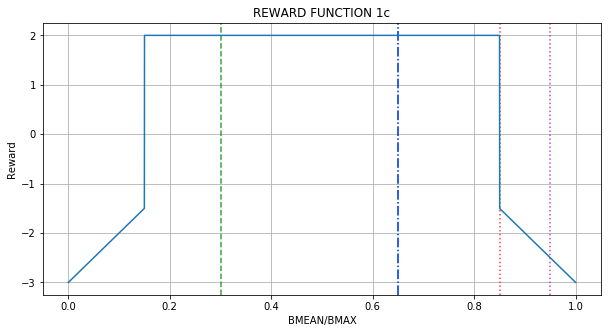

RF_1c(0)            =  -3.00
RF_1c(ENP_MARGIN/4) =  -3.00
RF_1c(ENP_MARGIN/2) =  -3.00
RF_1c(ENP_MARGIN)   =  -3.00

RF_1c(BMAX/2) =  -3.00
RF_1c(BMAX)   =  -3.00



In [15]:
#PLOT REWARD FUNCTIONS
x = np.arange(0,capm.BMAX)
y = [capm.rewardfn() for capm.btrack in x]

fig = plt.figure(figsize=(10,5))
ax = fig.add_subplot(111)
ax.set_title('REWARD FUNCTION 1c')
ax.set_xlabel('BMEAN/BMAX')
ax.set_ylabel('Reward')
ax.axvline((capm.ENP_MARGIN)/capm.BMAX, color='g',alpha=0.75, linestyle='--')
ax.axvline(1-(capm.BSAFE_LO)/capm.BMAX, color='c',alpha=0.75, linestyle='-.')
ax.axvline(  (capm.BSAFE_HI)/capm.BMAX, color='b',alpha=0.75, linestyle="-.")
ax.axvline(1- (capm.BLIM_LO)/capm.BMAX, color='r',alpha=0.75, linestyle=':')
ax.axvline(   (capm.BLIM_HI)/capm.BMAX, color='m',alpha=0.75, linestyle=":")
ax.plot(x/capm.BMAX,y)
ax.grid(True)
plt.show()

capm.enp = 0;            print("RF_1c(0)            = {:6.2f}".format(capm.rewardfn()) )
capm.enp = capm.ENP_MARGIN/4; print("RF_1c(ENP_MARGIN/4) = {:6.2f}".format(capm.rewardfn()) )
capm.enp = capm.ENP_MARGIN/2; print("RF_1c(ENP_MARGIN/2) = {:6.2f}".format(capm.rewardfn()) )
capm.enp = capm.ENP_MARGIN;   print("RF_1c(ENP_MARGIN)   = {:6.2f}".format(capm.rewardfn()) )
print("");
capm.enp = capm.BMAX/2; print("RF_1c(BMAX/2) = {:6.2f}".format(capm.rewardfn()) )
capm.enp = capm.BMAX;   print("RF_1c(BMAX)   = {:6.2f}".format(capm.rewardfn()) )
print("");

In [16]:
#TRAINING STARTS
tic = datetime.now()

Device:  cpu

Iteration 0:  WAKKANAI, 2003 
EPSILON = 5.000e-01
LR = 3.392e-05
Average Terminal Reward  = -1.215
Day Violations           =    213
Battery Limit Violations =   1493
Action MEAN              =  3.197
Action STD DEV           =  2.090


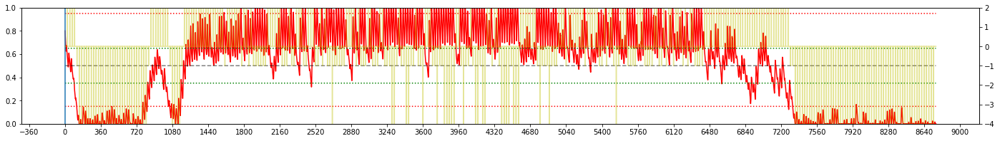


Iteration 1:  WAKKANAI, 2007 
EPSILON = 5.000e-01
LR = 4.174e-05
Average Terminal Reward  = -1.351
Day Violations           =    218
Battery Limit Violations =   1451
Action MEAN              =  3.083
Action STD DEV           =  2.013


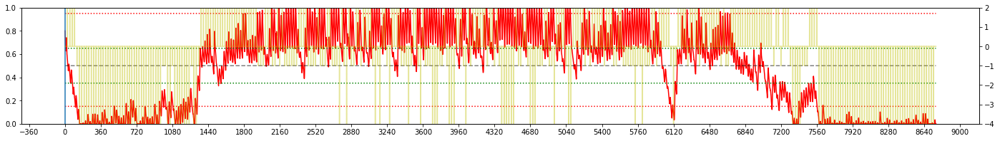


Iteration 2:  WAKKANAI, 2001 
EPSILON = 5.000e-01
LR = 5.000e-05
Average Terminal Reward  = -1.600
Day Violations           =    221
Battery Limit Violations =   1700
Action MEAN              =  3.001
Action STD DEV           =  1.969


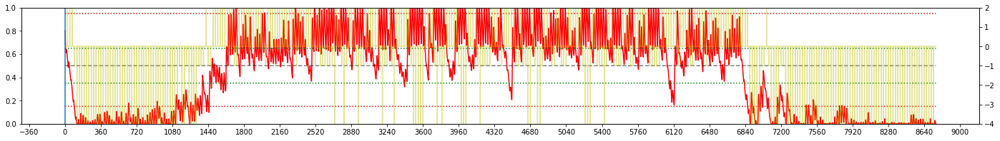


Iteration 3:  WAKKANAI, 2002 
EPSILON = 5.000e-01
LR = 5.826e-05
Average Terminal Reward  = -1.443
Day Violations           =    221
Battery Limit Violations =   1643
Action MEAN              =  3.075
Action STD DEV           =  2.026


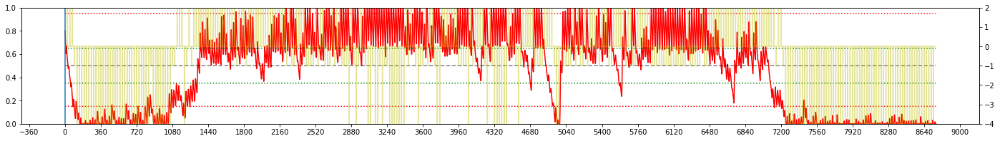


Iteration 4:  WAKKANAI, 2000 
EPSILON = 5.001e-01
LR = 6.608e-05
Average Terminal Reward  = -0.787
Day Violations           =    180
Battery Limit Violations =   1357
Action MEAN              =  2.936
Action STD DEV           =  1.933


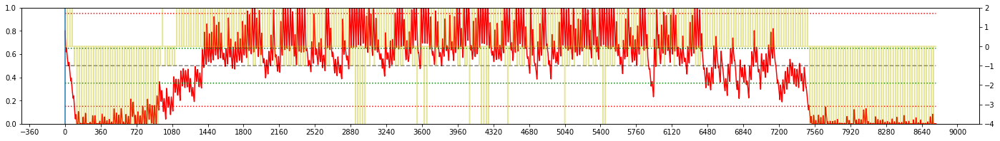


Iteration 5:  WAKKANAI, 2004 
EPSILON = 5.001e-01
LR = 7.311e-05
Average Terminal Reward  = -1.746
Day Violations           =    232
Battery Limit Violations =   1693
Action MEAN              =  3.107
Action STD DEV           =  2.022


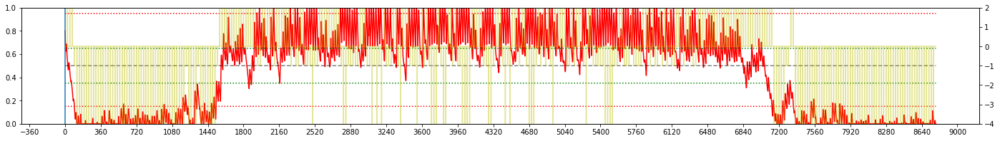


Iteration 6:  WAKKANAI, 2003 
EPSILON = 5.001e-01
LR = 7.914e-05
Average Terminal Reward  = -2.089
Day Violations           =    252
Battery Limit Violations =   2612
Action MEAN              =  4.441
Action STD DEV           =  2.652


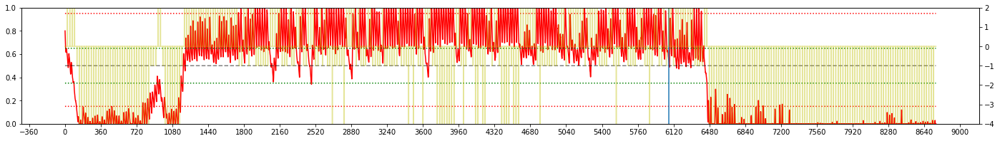


Iteration 7:  WAKKANAI, 2006 
EPSILON = 5.001e-01
LR = 8.411e-05
Average Terminal Reward  = -0.957
Day Violations           =    158
Battery Limit Violations =   2735
Action MEAN              =  4.749
Action STD DEV           =  3.207


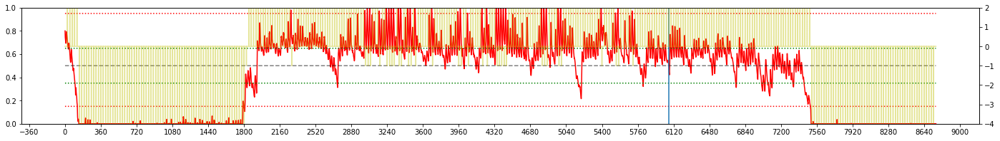


Iteration 8:  WAKKANAI, 2003 
EPSILON = 5.001e-01
LR = 8.808e-05
Average Terminal Reward  = -1.607
Day Violations           =    196
Battery Limit Violations =   2218
Action MEAN              =  4.176
Action STD DEV           =  2.981


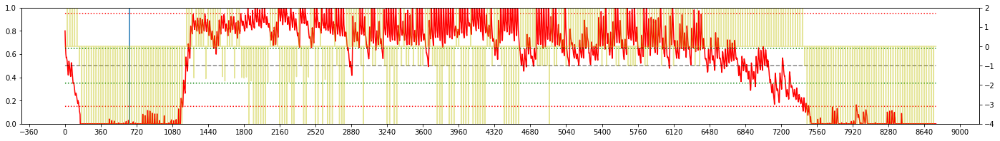


Iteration 9:  WAKKANAI, 2006 
EPSILON = 5.001e-01
LR = 9.116e-05
Average Terminal Reward  = -0.472
Day Violations           =    145
Battery Limit Violations =   1371
Action MEAN              =  3.557
Action STD DEV           =  2.750


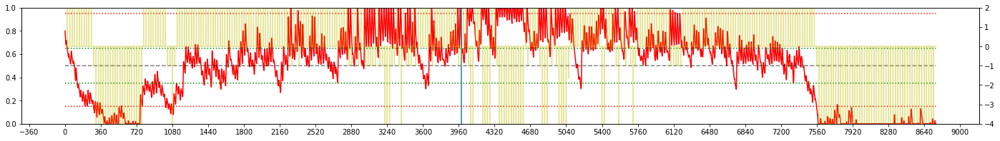


Iteration 10:  WAKKANAI, 2008 
EPSILON = 5.002e-01
LR = 9.350e-05
Average Terminal Reward  =  0.164
Day Violations           =    109
Battery Limit Violations =   1052
Action MEAN              =  3.404
Action STD DEV           =  2.617


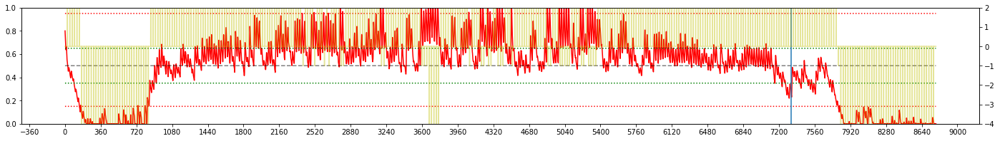


Iteration 11:  WAKKANAI, 2007 
EPSILON = 5.002e-01
LR = 9.526e-05
Average Terminal Reward  =  0.622
Day Violations           =     88
Battery Limit Violations =    809
Action MEAN              =  3.532
Action STD DEV           =  2.639


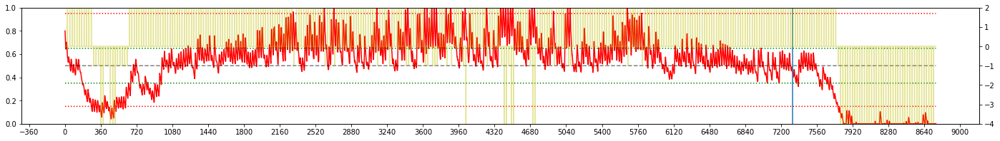


Iteration 12:  WAKKANAI, 2000 
EPSILON = 5.003e-01
LR = 9.656e-05
Average Terminal Reward  =  0.275
Day Violations           =     98
Battery Limit Violations =   1114
Action MEAN              =  3.518
Action STD DEV           =  2.853


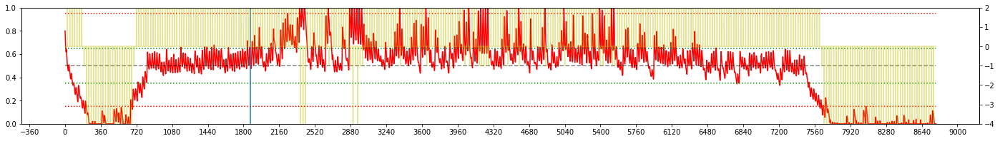


Iteration 13:  WAKKANAI, 2002 
EPSILON = 5.003e-01
LR = 9.751e-05
Average Terminal Reward  =  0.200
Day Violations           =    104
Battery Limit Violations =   1136
Action MEAN              =  3.742
Action STD DEV           =  3.165


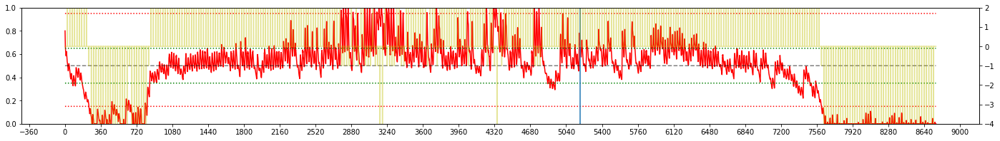


Iteration 14:  WAKKANAI, 2002 
EPSILON = 5.004e-01
LR = 9.820e-05
Average Terminal Reward  =  0.195
Day Violations           =     98
Battery Limit Violations =   1217
Action MEAN              =  3.880
Action STD DEV           =  3.171


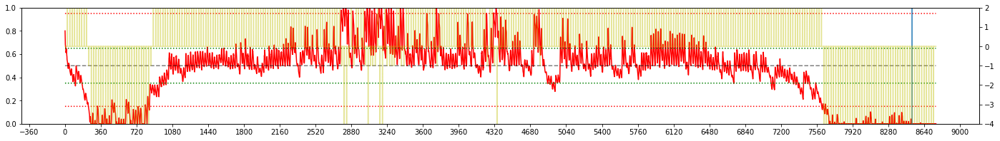


Iteration 15:  WAKKANAI, 2001 
EPSILON = 5.005e-01
LR = 9.870e-05
Average Terminal Reward  =  0.369
Day Violations           =     88
Battery Limit Violations =   1058
Action MEAN              =  3.774
Action STD DEV           =  3.236


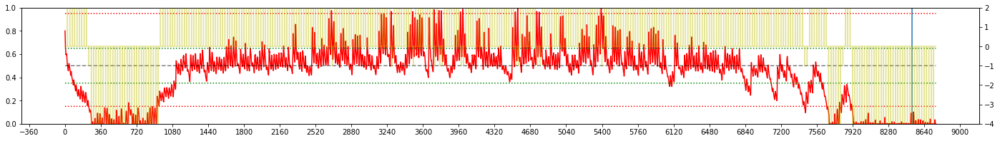


Iteration 16:  WAKKANAI, 2003 
EPSILON = 5.006e-01
LR = 9.907e-05
Average Terminal Reward  =  0.375
Day Violations           =     91
Battery Limit Violations =    972
Action MEAN              =  4.013
Action STD DEV           =  3.248


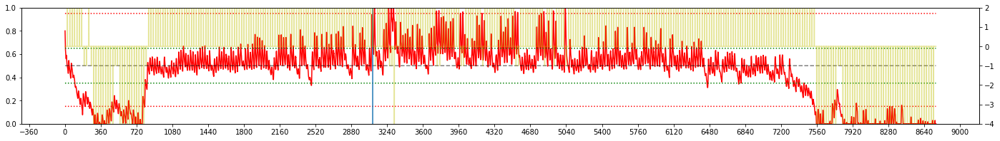


Iteration 17:  WAKKANAI, 2000 
EPSILON = 5.007e-01
LR = 9.933e-05
Average Terminal Reward  =  0.572
Day Violations           =     71
Battery Limit Violations =   1183
Action MEAN              =  3.798
Action STD DEV           =  3.075


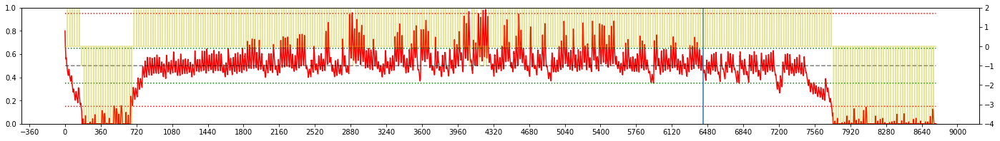


Iteration 18:  WAKKANAI, 2003 
EPSILON = 5.008e-01
LR = 9.952e-05
Average Terminal Reward  =  0.346
Day Violations           =     80
Battery Limit Violations =   1310
Action MEAN              =  4.292
Action STD DEV           =  3.217


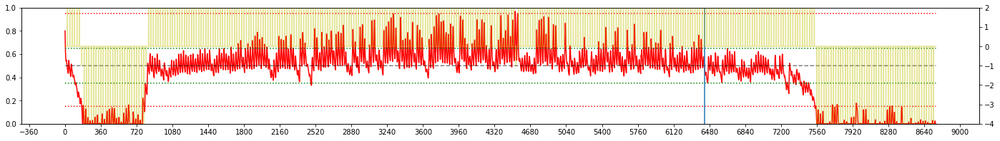


Iteration 19:  WAKKANAI, 2009 
EPSILON = 5.010e-01
LR = 9.966e-05
Average Terminal Reward  =  0.080
Day Violations           =     92
Battery Limit Violations =   1429
Action MEAN              =  4.001
Action STD DEV           =  3.159


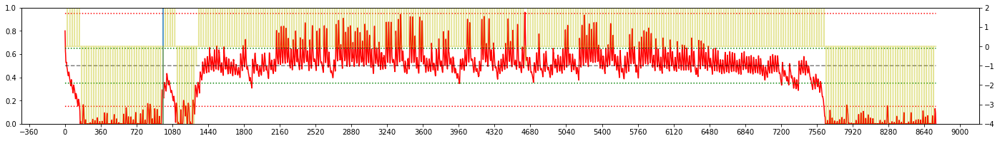


Iteration 20:  WAKKANAI, 2004 
EPSILON = 5.012e-01
LR = 9.975e-05
Average Terminal Reward  =  0.411
Day Violations           =     78
Battery Limit Violations =   1188
Action MEAN              =  3.870
Action STD DEV           =  3.104


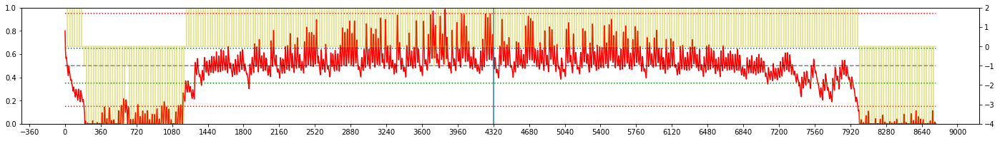


Iteration 21:  WAKKANAI, 2000 
EPSILON = 5.015e-01
LR = 9.982e-05
Average Terminal Reward  =  0.579
Day Violations           =     70
Battery Limit Violations =   1099
Action MEAN              =  3.610
Action STD DEV           =  3.017


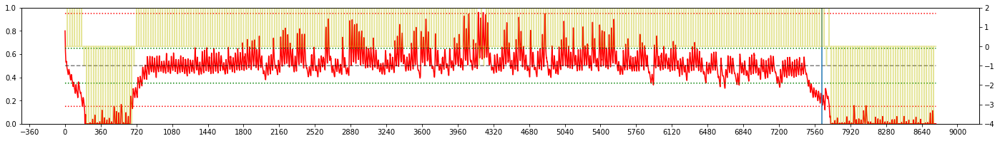


Iteration 22:  WAKKANAI, 2003 
EPSILON = 5.018e-01
LR = 9.987e-05
Average Terminal Reward  =  0.349
Day Violations           =     79
Battery Limit Violations =   1184
Action MEAN              =  3.874
Action STD DEV           =  3.160


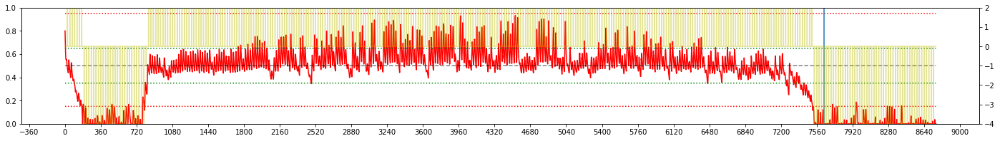


Iteration 23:  WAKKANAI, 2002 
EPSILON = 5.022e-01
LR = 9.991e-05
Average Terminal Reward  =  0.467
Day Violations           =     75
Battery Limit Violations =   1148
Action MEAN              =  3.764
Action STD DEV           =  3.110


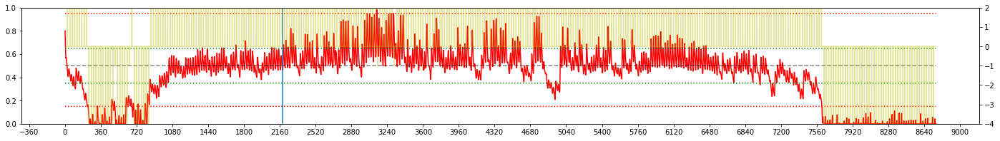


Iteration 24:  WAKKANAI, 2005 
EPSILON = 5.027e-01
LR = 9.993e-05
Average Terminal Reward  =  0.351
Day Violations           =     80
Battery Limit Violations =   1189
Action MEAN              =  3.755
Action STD DEV           =  3.072


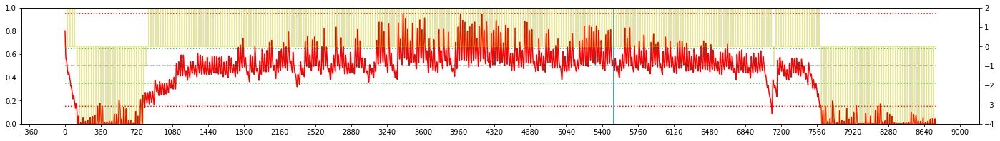


Iteration 25:  WAKKANAI, 2005 
EPSILON = 5.033e-01
LR = 9.995e-05
Average Terminal Reward  =  0.331
Day Violations           =     83
Battery Limit Violations =   1140
Action MEAN              =  3.698
Action STD DEV           =  3.040


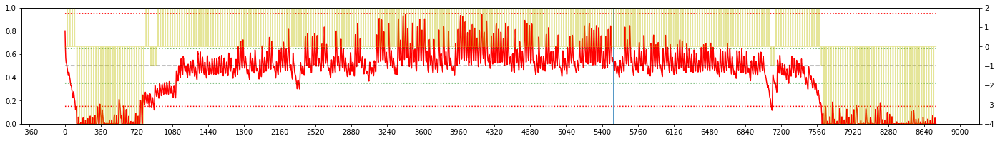


Iteration 26:  WAKKANAI, 2005 
EPSILON = 5.041e-01
LR = 9.997e-05
Average Terminal Reward  =  0.348
Day Violations           =     83
Battery Limit Violations =   1179
Action MEAN              =  3.791
Action STD DEV           =  3.052


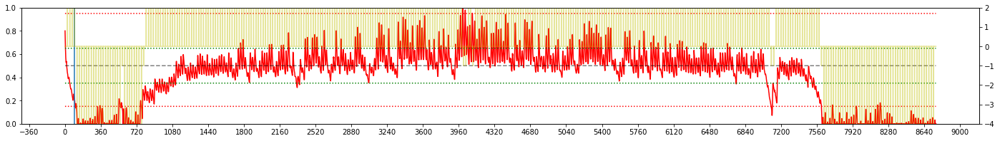


Iteration 27:  WAKKANAI, 2008 
EPSILON = 5.050e-01
LR = 9.998e-05
Average Terminal Reward  =  0.477
Day Violations           =     74
Battery Limit Violations =   1054
Action MEAN              =  3.438
Action STD DEV           =  2.825


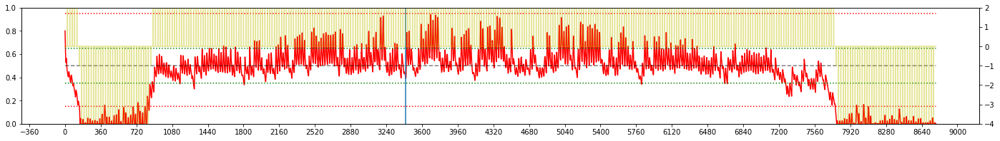


Iteration 28:  WAKKANAI, 2009 
EPSILON = 5.061e-01
LR = 9.998e-05
Average Terminal Reward  =  0.401
Day Violations           =     78
Battery Limit Violations =   1065
Action MEAN              =  3.401
Action STD DEV           =  2.898


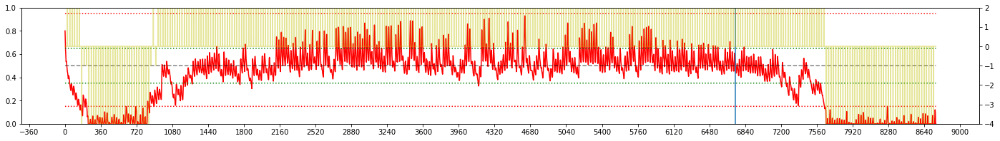


Iteration 29:  WAKKANAI, 2003 
EPSILON = 5.074e-01
LR = 9.999e-05
Average Terminal Reward  =  0.375
Day Violations           =     78
Battery Limit Violations =   1243
Action MEAN              =  3.870
Action STD DEV           =  2.959


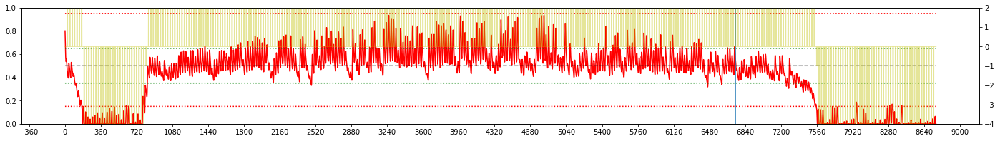


Iteration 30:  WAKKANAI, 2009 
EPSILON = 5.090e-01
LR = 9.999e-05
Average Terminal Reward  =  0.106
Day Violations           =     94
Battery Limit Violations =   1328
Action MEAN              =  3.643
Action STD DEV           =  3.036


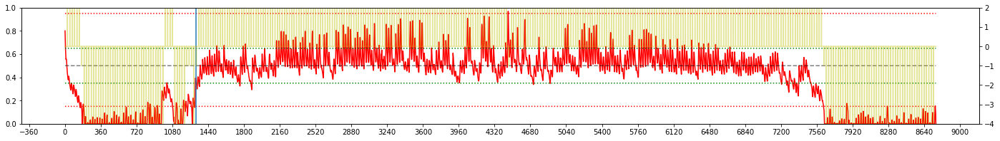


Iteration 31:  WAKKANAI, 2005 
EPSILON = 5.109e-01
LR = 9.999e-05
Average Terminal Reward  =  0.347
Day Violations           =     82
Battery Limit Violations =   1099
Action MEAN              =  3.445
Action STD DEV           =  2.883


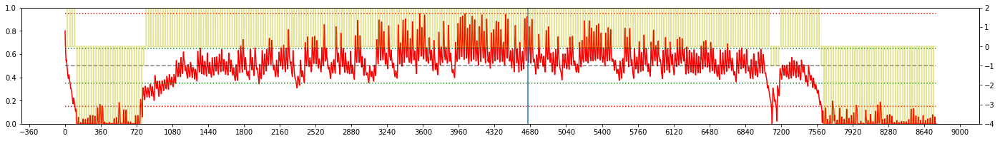


Iteration 32:  WAKKANAI, 2006 
EPSILON = 5.133e-01
LR = 1.000e-04
Average Terminal Reward  =  0.411
Day Violations           =     80
Battery Limit Violations =   1081
Action MEAN              =  3.282
Action STD DEV           =  2.746


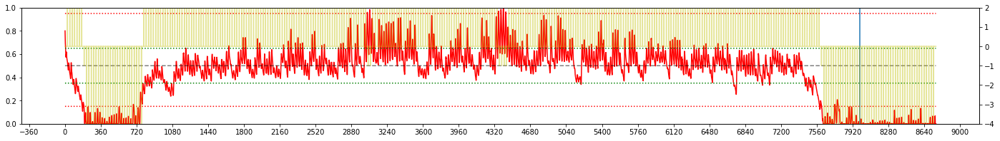


Iteration 33:  WAKKANAI, 2008 
EPSILON = 5.161e-01
LR = 1.000e-04
Average Terminal Reward  =  0.417
Day Violations           =     79
Battery Limit Violations =   1194
Action MEAN              =  3.504
Action STD DEV           =  2.841


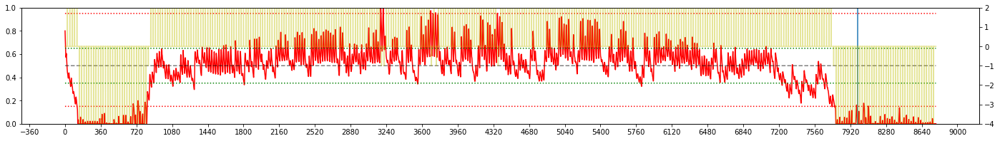


Iteration 34:  WAKKANAI, 2007 
EPSILON = 5.196e-01
LR = 1.000e-04
Average Terminal Reward  =  0.346
Day Violations           =     90
Battery Limit Violations =   1154
Action MEAN              =  3.584
Action STD DEV           =  2.901


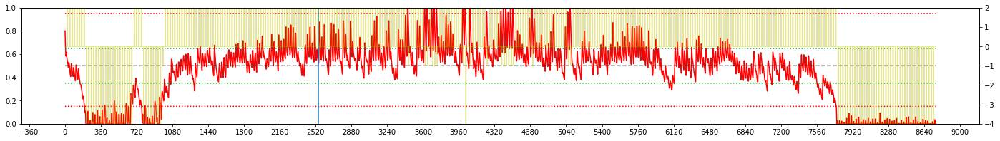


Iteration 35:  WAKKANAI, 2002 
EPSILON = 5.237e-01
LR = 1.000e-04
Average Terminal Reward  =  0.340
Day Violations           =     86
Battery Limit Violations =   1243
Action MEAN              =  3.676
Action STD DEV           =  3.053


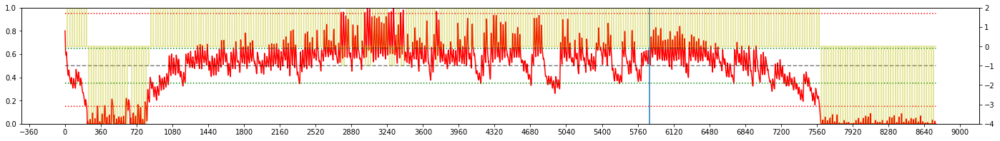


Iteration 36:  WAKKANAI, 2007 
EPSILON = 5.287e-01
LR = 1.000e-04
Average Terminal Reward  =  0.283
Day Violations           =     92
Battery Limit Violations =   1160
Action MEAN              =  3.522
Action STD DEV           =  2.983


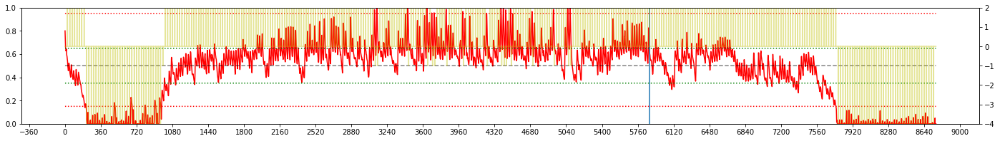


Iteration 37:  WAKKANAI, 2000 
EPSILON = 5.346e-01
LR = 1.000e-04
Average Terminal Reward  =  0.438
Day Violations           =     81
Battery Limit Violations =   1160
Action MEAN              =  3.374
Action STD DEV           =  2.815


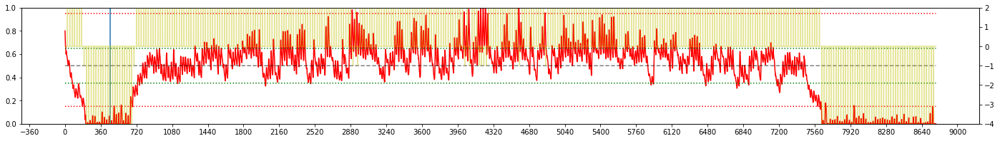


Iteration 38:  WAKKANAI, 2007 
EPSILON = 5.416e-01
LR = 1.000e-04
Average Terminal Reward  =  0.502
Day Violations           =     84
Battery Limit Violations =   1079
Action MEAN              =  3.604
Action STD DEV           =  2.915


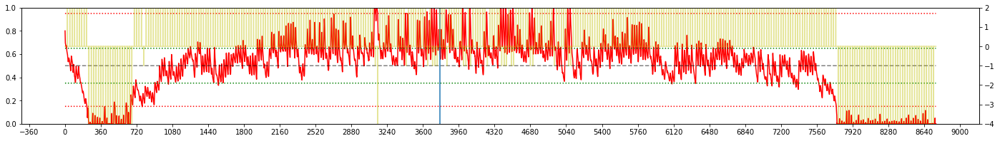


Iteration 39:  WAKKANAI, 2009 
EPSILON = 5.499e-01
LR = 1.000e-04
Average Terminal Reward  =  0.283
Day Violations           =     88
Battery Limit Violations =   1222
Action MEAN              =  3.451
Action STD DEV           =  2.943


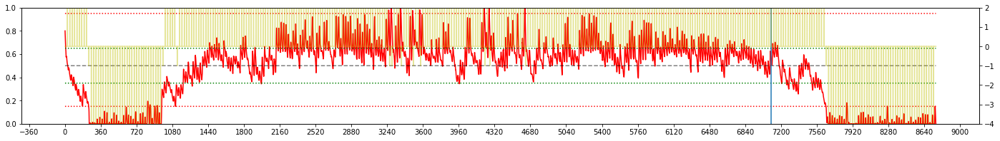


Iteration 40:  WAKKANAI, 2005 
EPSILON = 5.596e-01
LR = 1.000e-04
Average Terminal Reward  =  0.227
Day Violations           =     98
Battery Limit Violations =   1165
Action MEAN              =  3.603
Action STD DEV           =  3.012


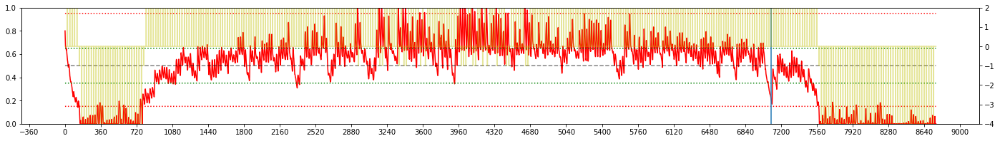


Iteration 41:  WAKKANAI, 2008 
EPSILON = 5.709e-01
LR = 1.000e-04
Average Terminal Reward  =  0.418
Day Violations           =     86
Battery Limit Violations =   1104
Action MEAN              =  3.643
Action STD DEV           =  3.068


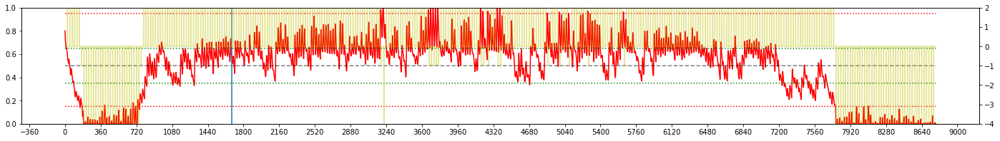


Iteration 42:  WAKKANAI, 2003 
EPSILON = 5.840e-01
LR = 1.000e-04
Average Terminal Reward  =  0.260
Day Violations           =     92
Battery Limit Violations =   1216
Action MEAN              =  3.855
Action STD DEV           =  3.171


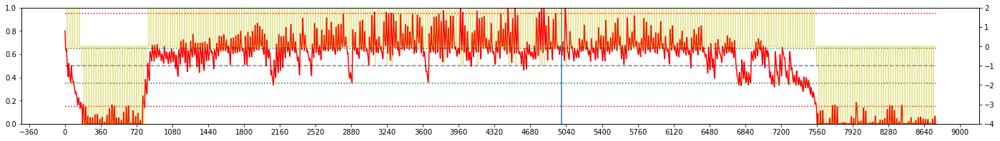


Iteration 43:  WAKKANAI, 2005 
EPSILON = 5.989e-01
LR = 1.000e-04
Average Terminal Reward  =  0.226
Day Violations           =     97
Battery Limit Violations =   1185
Action MEAN              =  3.689
Action STD DEV           =  3.154


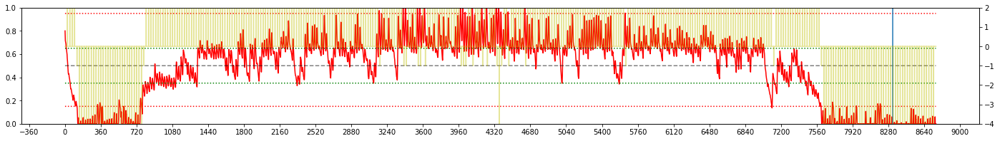


Iteration 44:  WAKKANAI, 2008 
EPSILON = 6.157e-01
LR = 1.000e-04
Average Terminal Reward  =  0.380
Day Violations           =     88
Battery Limit Violations =   1061
Action MEAN              =  3.513
Action STD DEV           =  3.080


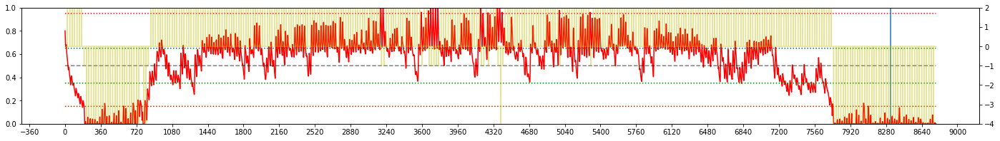


Iteration 45:  WAKKANAI, 2000 
EPSILON = 6.345e-01
LR = 1.000e-04
Average Terminal Reward  =  0.441
Day Violations           =     84
Battery Limit Violations =   1089
Action MEAN              =  3.628
Action STD DEV           =  3.025


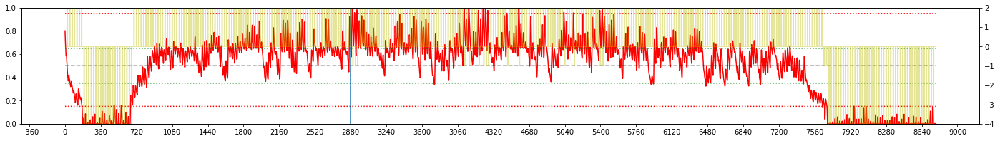


Iteration 46:  WAKKANAI, 2001 
EPSILON = 6.550e-01
LR = 1.000e-04
Average Terminal Reward  =  0.052
Day Violations           =    103
Battery Limit Violations =   1280
Action MEAN              =  3.869
Action STD DEV           =  3.251


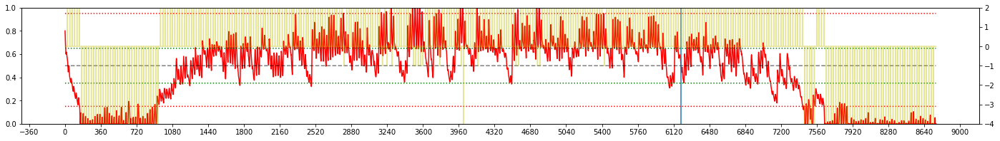


Iteration 47:  WAKKANAI, 2007 
EPSILON = 6.772e-01
LR = 1.000e-04
Average Terminal Reward  =  0.556
Day Violations           =     83
Battery Limit Violations =    956
Action MEAN              =  3.799
Action STD DEV           =  3.247


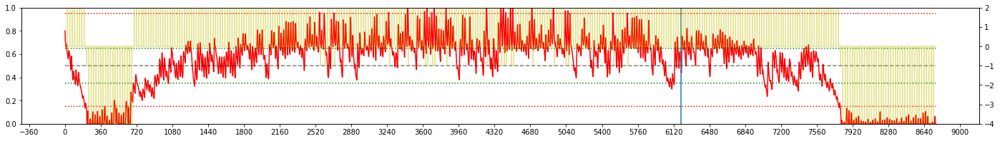


Iteration 48:  WAKKANAI, 2006 
EPSILON = 7.007e-01
LR = 1.000e-04
Average Terminal Reward  =  0.480
Day Violations           =     85
Battery Limit Violations =    903
Action MEAN              =  3.333
Action STD DEV           =  2.849


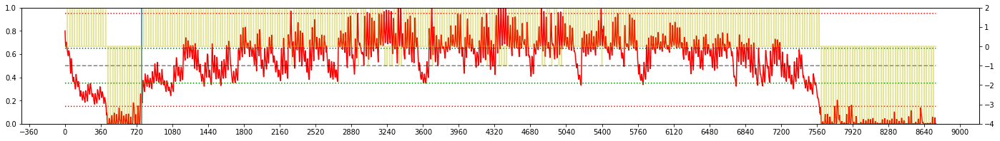


Iteration 49:  WAKKANAI, 2009 
EPSILON = 7.251e-01
LR = 1.000e-04
Average Terminal Reward  =  0.034
Day Violations           =    111
Battery Limit Violations =   1292
Action MEAN              =  3.768
Action STD DEV           =  3.126


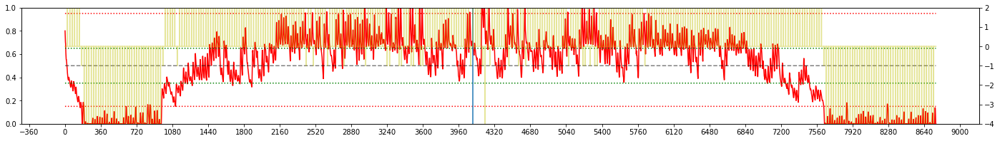


Iteration 50:  WAKKANAI, 2007 
EPSILON = 7.500e-01
LR = 1.000e-04
Average Terminal Reward  =  0.485
Day Violations           =     89
Battery Limit Violations =    960
Action MEAN              =  3.731
Action STD DEV           =  3.148


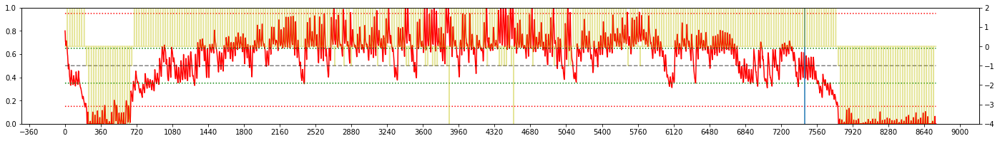


Iteration 51:  WAKKANAI, 2008 
EPSILON = 7.749e-01
LR = 8.750e-05
Average Terminal Reward  =  0.350
Day Violations           =     95
Battery Limit Violations =    993
Action MEAN              =  3.518
Action STD DEV           =  3.069


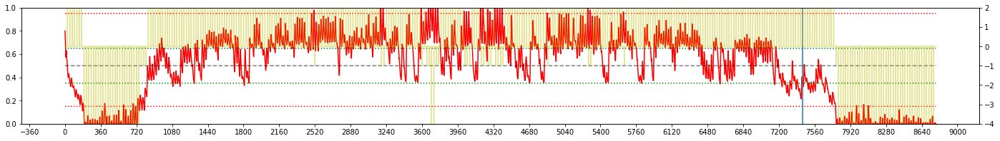


Iteration 52:  WAKKANAI, 2001 
EPSILON = 7.993e-01
LR = 7.681e-05
Average Terminal Reward  =  0.159
Day Violations           =    109
Battery Limit Violations =   1049
Action MEAN              =  3.331
Action STD DEV           =  2.934


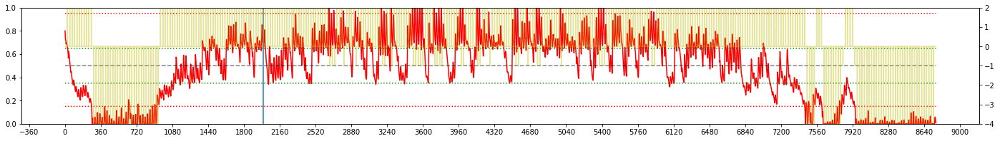


Iteration 53:  WAKKANAI, 2001 
EPSILON = 8.228e-01
LR = 6.767e-05
Average Terminal Reward  =  0.120
Day Violations           =    111
Battery Limit Violations =   1016
Action MEAN              =  3.154
Action STD DEV           =  2.853


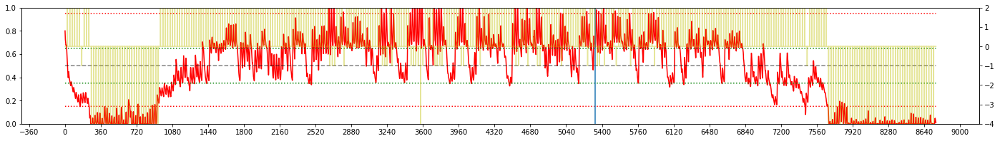


Iteration 54:  WAKKANAI, 2002 
EPSILON = 8.450e-01
LR = 5.986e-05
Average Terminal Reward  =  0.220
Day Violations           =    110
Battery Limit Violations =   1137
Action MEAN              =  3.291
Action STD DEV           =  2.971


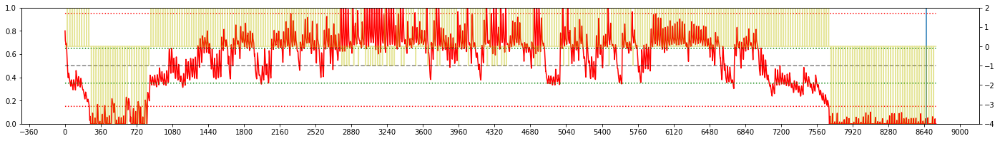


Iteration 55:  WAKKANAI, 2004 
EPSILON = 8.655e-01
LR = 5.318e-05
Average Terminal Reward  =  0.668
Day Violations           =     87
Battery Limit Violations =    845
Action MEAN              =  3.436
Action STD DEV           =  3.153


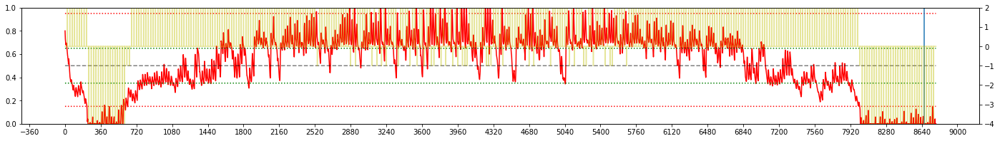


Iteration 56:  WAKKANAI, 2007 
EPSILON = 8.843e-01
LR = 4.747e-05
Average Terminal Reward  =  0.445
Day Violations           =     97
Battery Limit Violations =   1000
Action MEAN              =  3.645
Action STD DEV           =  3.214


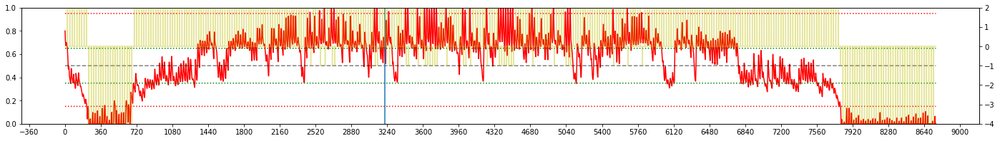


Iteration 57:  WAKKANAI, 2008 
EPSILON = 9.011e-01
LR = 4.259e-05
Average Terminal Reward  =  0.248
Day Violations           =    105
Battery Limit Violations =   1052
Action MEAN              =  3.479
Action STD DEV           =  3.094


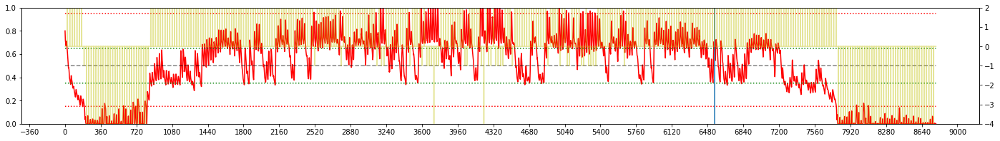


Iteration 58:  WAKKANAI, 2006 
EPSILON = 9.160e-01
LR = 3.841e-05
Average Terminal Reward  =  0.726
Day Violations           =     81
Battery Limit Violations =    817
Action MEAN              =  3.145
Action STD DEV           =  2.922


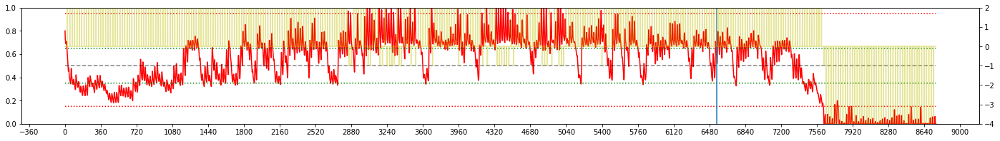


Iteration 59:  WAKKANAI, 2006 
EPSILON = 9.291e-01
LR = 3.484e-05
Average Terminal Reward  =  0.717
Day Violations           =     82
Battery Limit Violations =    834
Action MEAN              =  3.614
Action STD DEV           =  3.455


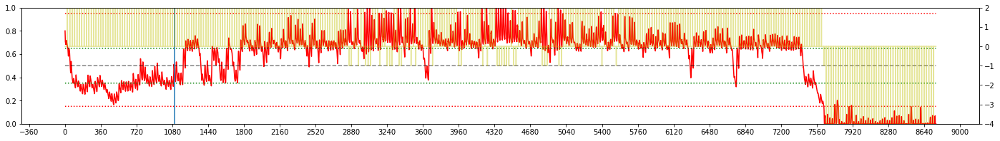


Iteration 60:  WAKKANAI, 2005 
EPSILON = 9.404e-01
LR = 3.179e-05
Average Terminal Reward  =  0.447
Day Violations           =    101
Battery Limit Violations =    904
Action MEAN              =  3.552
Action STD DEV           =  3.533


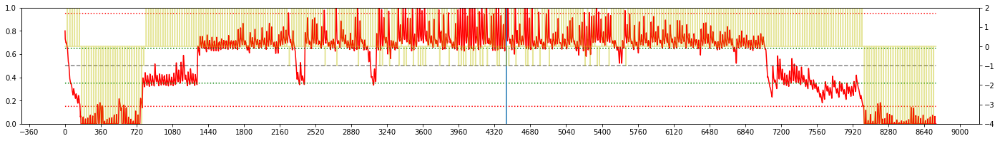


Iteration 61:  WAKKANAI, 2009 
EPSILON = 9.501e-01
LR = 2.918e-05
Average Terminal Reward  =  0.247
Day Violations           =    109
Battery Limit Violations =   1108
Action MEAN              =  3.962
Action STD DEV           =  3.816


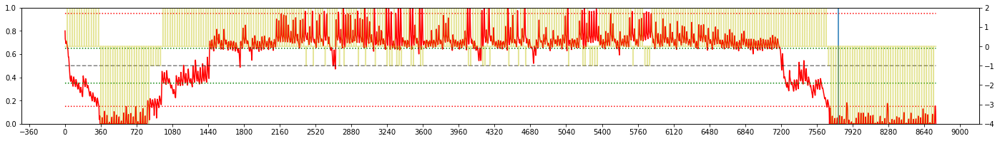


Iteration 62:  WAKKANAI, 2006 
EPSILON = 9.584e-01
LR = 2.695e-05
Average Terminal Reward  =  0.702
Day Violations           =     83
Battery Limit Violations =    828
Action MEAN              =  3.354
Action STD DEV           =  3.489


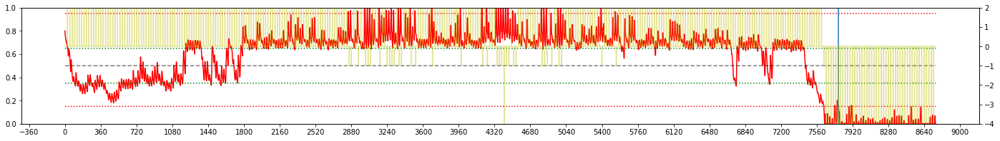


Iteration 63:  WAKKANAI, 2003 
EPSILON = 9.654e-01
LR = 2.504e-05
Average Terminal Reward  =  0.899
Day Violations           =     77
Battery Limit Violations =    621
Action MEAN              =  3.493
Action STD DEV           =  3.653


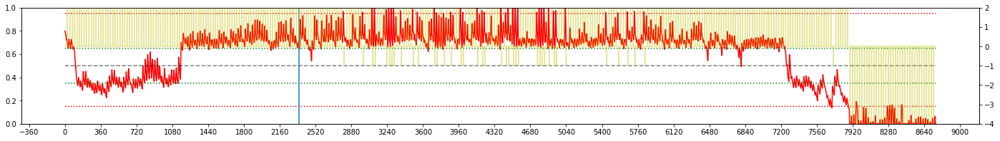


Iteration 64:  WAKKANAI, 2004 
EPSILON = 9.713e-01
LR = 2.341e-05
Average Terminal Reward  =  0.697
Day Violations           =     82
Battery Limit Violations =    836
Action MEAN              =  3.569
Action STD DEV           =  3.699


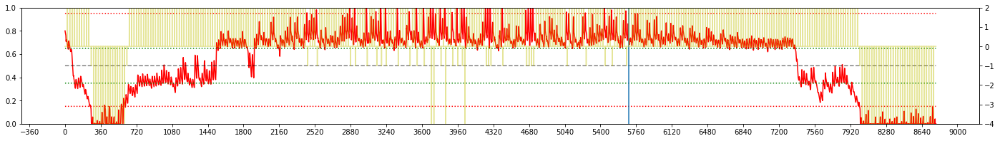


Iteration 65:  WAKKANAI, 2001 
EPSILON = 9.763e-01
LR = 2.202e-05
Average Terminal Reward  =  0.782
Day Violations           =     84
Battery Limit Violations =    725
Action MEAN              =  3.457
Action STD DEV           =  3.642


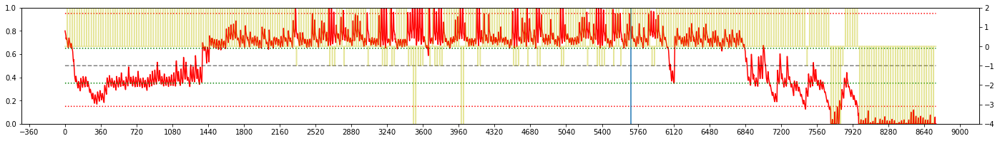


Iteration 66:  WAKKANAI, 2000 
EPSILON = 9.804e-01
LR = 2.082e-05
Average Terminal Reward  =  0.544
Day Violations           =     90
Battery Limit Violations =    885
Action MEAN              =  3.420
Action STD DEV           =  3.611


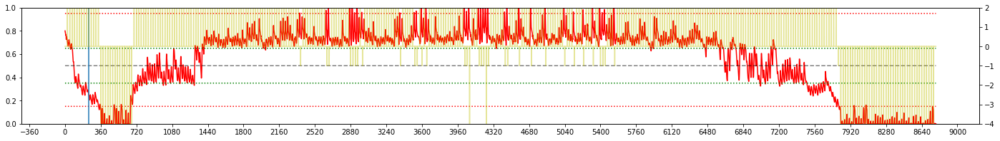


Iteration 67:  WAKKANAI, 2003 
EPSILON = 9.839e-01
LR = 1.980e-05
Average Terminal Reward  =  0.849
Day Violations           =     81
Battery Limit Violations =    646
Action MEAN              =  3.716
Action STD DEV           =  3.846


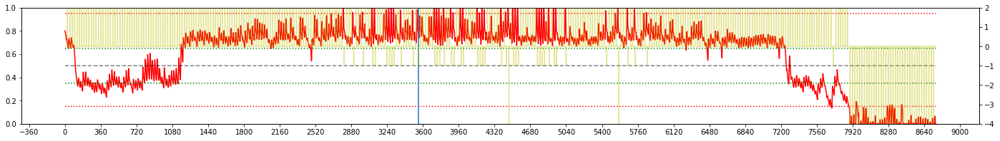


Iteration 68:  WAKKANAI, 2003 
EPSILON = 9.867e-01
LR = 1.893e-05
Average Terminal Reward  =  0.686
Day Violations           =     89
Battery Limit Violations =    636
Action MEAN              =  3.250
Action STD DEV           =  3.529


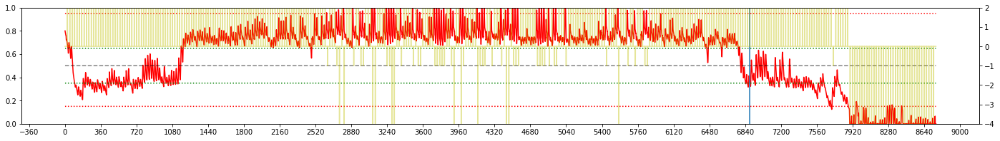


Iteration 69:  WAKKANAI, 2000 
EPSILON = 9.891e-01
LR = 1.819e-05
Average Terminal Reward  =  0.478
Day Violations           =     95
Battery Limit Violations =    925
Action MEAN              =  3.341
Action STD DEV           =  3.555


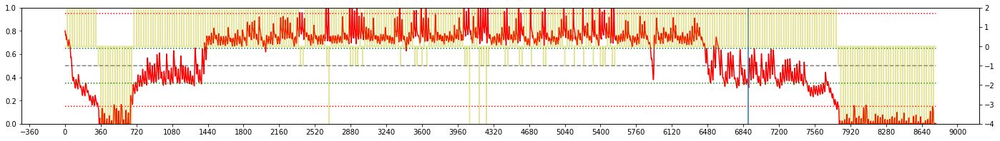


Iteration 70:  WAKKANAI, 2009 
EPSILON = 9.910e-01
LR = 1.755e-05
Average Terminal Reward  =  0.136
Day Violations           =    120
Battery Limit Violations =    988
Action MEAN              =  3.331
Action STD DEV           =  3.628


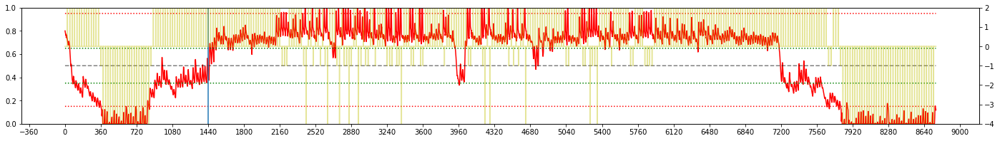


Iteration 71:  WAKKANAI, 2007 
EPSILON = 9.926e-01
LR = 1.701e-05
Average Terminal Reward  =  0.583
Day Violations           =     94
Battery Limit Violations =    793
Action MEAN              =  3.609
Action STD DEV           =  3.647


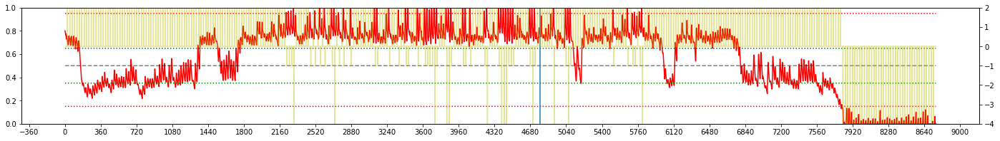


Iteration 72:  WAKKANAI, 2004 
EPSILON = 9.939e-01
LR = 1.654e-05
Average Terminal Reward  =  0.499
Day Violations           =     96
Battery Limit Violations =    767
Action MEAN              =  3.029
Action STD DEV           =  3.306


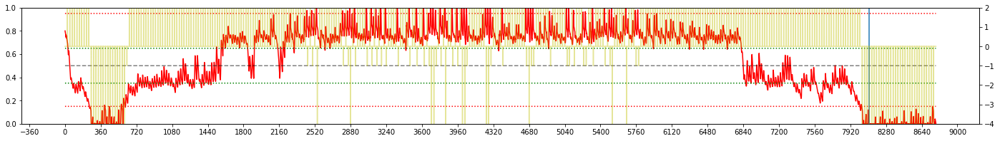


Iteration 73:  WAKKANAI, 2003 
EPSILON = 9.950e-01
LR = 1.614e-05
Average Terminal Reward  =  0.645
Day Violations           =     94
Battery Limit Violations =    652
Action MEAN              =  3.181
Action STD DEV           =  3.292


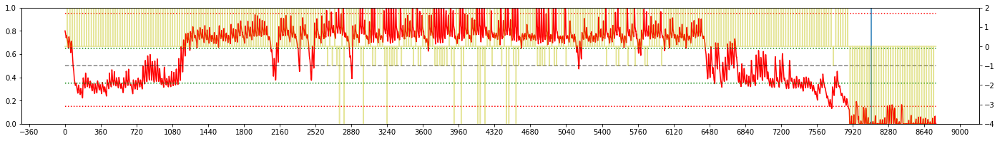


Iteration 74:  WAKKANAI, 2005 
EPSILON = 9.959e-01
LR = 1.580e-05
Average Terminal Reward  =  0.293
Day Violations           =    116
Battery Limit Violations =    697
Action MEAN              =  3.061
Action STD DEV           =  3.052


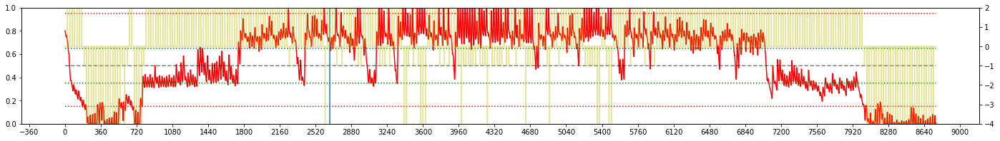


Iteration 75:  WAKKANAI, 2000 
EPSILON = 9.967e-01
LR = 1.551e-05
Average Terminal Reward  =  0.343
Day Violations           =    107
Battery Limit Violations =    714
Action MEAN              =  2.848
Action STD DEV           =  2.655


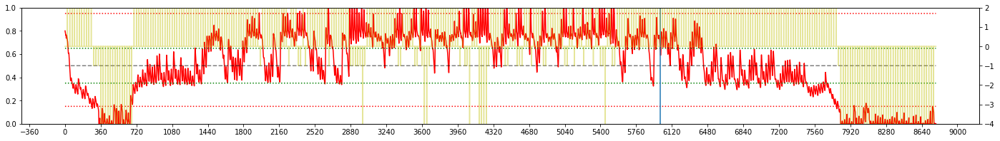


Iteration 76:  WAKKANAI, 2006 
EPSILON = 9.973e-01
LR = 1.526e-05
Average Terminal Reward  =  0.584
Day Violations           =     89
Battery Limit Violations =    554
Action MEAN              =  2.896
Action STD DEV           =  2.189


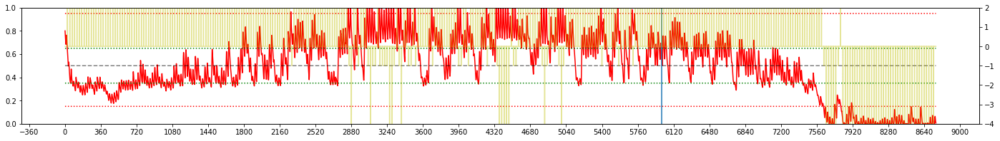


Iteration 77:  WAKKANAI, 2001 
EPSILON = 9.978e-01
LR = 1.505e-05
Average Terminal Reward  = -0.160
Day Violations           =    123
Battery Limit Violations =    898
Action MEAN              =  2.871
Action STD DEV           =  2.217


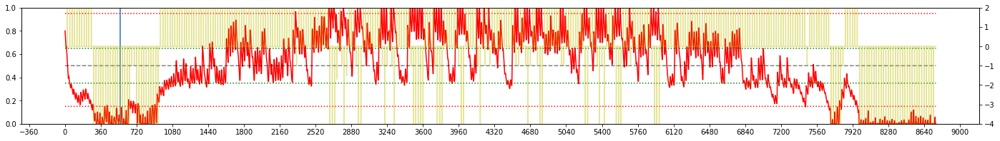


Iteration 78:  WAKKANAI, 2007 
EPSILON = 9.982e-01
LR = 1.487e-05
Average Terminal Reward  =  0.407
Day Violations           =    112
Battery Limit Violations =    546
Action MEAN              =  2.982
Action STD DEV           =  2.228


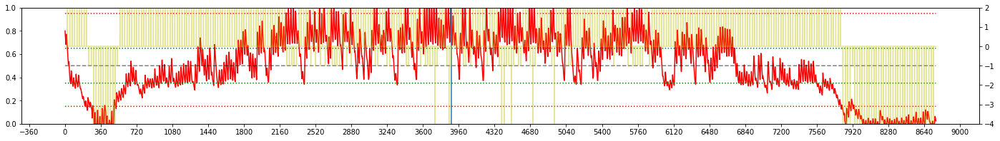


Iteration 79:  WAKKANAI, 2004 
EPSILON = 9.985e-01
LR = 1.471e-05
Average Terminal Reward  =  0.624
Day Violations           =     98
Battery Limit Violations =    406
Action MEAN              =  2.968
Action STD DEV           =  2.281


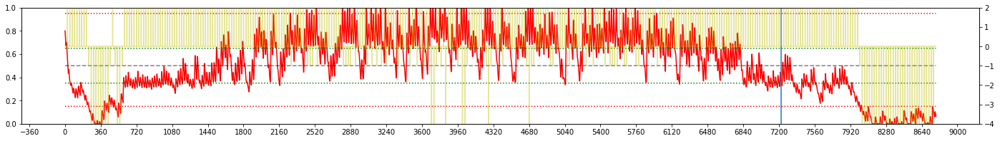


Iteration 80:  WAKKANAI, 2005 
EPSILON = 9.988e-01
LR = 1.458e-05
Average Terminal Reward  =  0.786
Day Violations           =     95
Battery Limit Violations =    365
Action MEAN              =  2.998
Action STD DEV           =  2.294


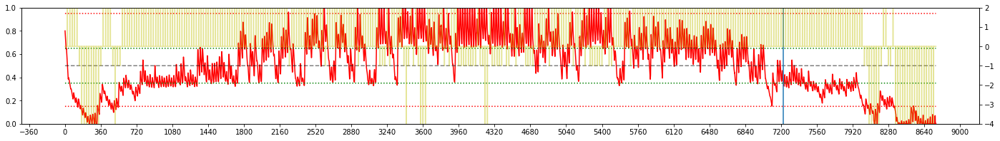


Iteration 81:  WAKKANAI, 2005 
EPSILON = 9.990e-01
LR = 1.446e-05
Average Terminal Reward  =  0.734
Day Violations           =     99
Battery Limit Violations =    374
Action MEAN              =  2.985
Action STD DEV           =  2.252


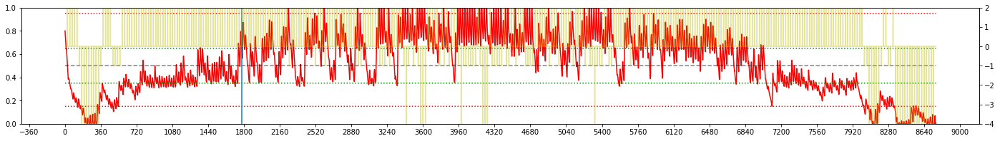


Iteration 82:  WAKKANAI, 2001 
EPSILON = 9.992e-01
LR = 1.437e-05
Average Terminal Reward  =  0.621
Day Violations           =     99
Battery Limit Violations =    565
Action MEAN              =  2.846
Action STD DEV           =  2.129


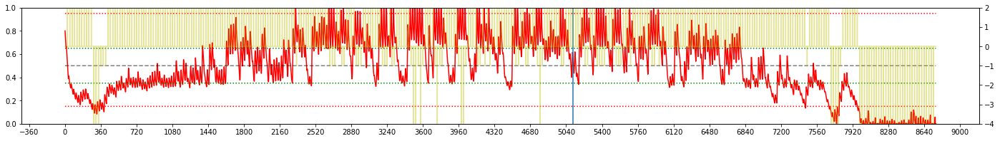


Iteration 83:  WAKKANAI, 2006 
EPSILON = 9.993e-01
LR = 1.428e-05
Average Terminal Reward  =  0.691
Day Violations           =     90
Battery Limit Violations =    499
Action MEAN              =  2.910
Action STD DEV           =  2.118


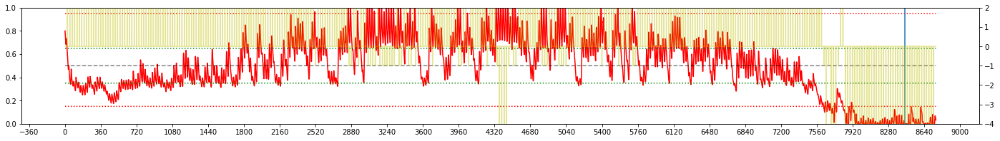


Iteration 84:  WAKKANAI, 2009 
EPSILON = 9.994e-01
LR = 1.421e-05
Average Terminal Reward  =  0.463
Day Violations           =    110
Battery Limit Violations =    532
Action MEAN              =  2.901
Action STD DEV           =  2.104


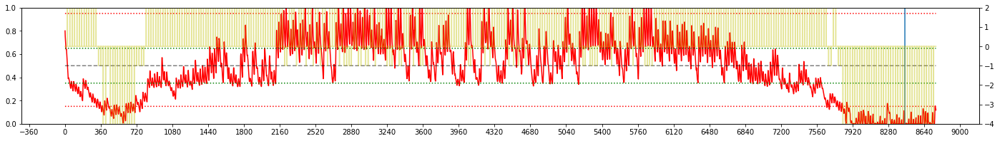


Iteration 85:  WAKKANAI, 2003 
EPSILON = 9.995e-01
LR = 1.415e-05
Average Terminal Reward  =  0.867
Day Violations           =     91
Battery Limit Violations =    425
Action MEAN              =  3.156
Action STD DEV           =  2.142


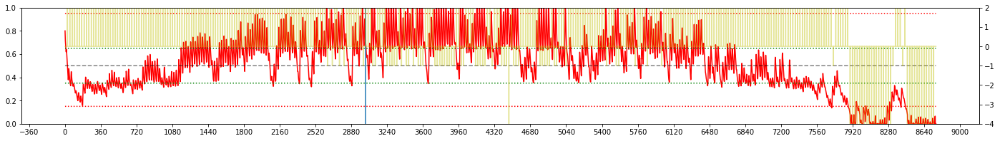


Iteration 86:  WAKKANAI, 2003 
EPSILON = 9.996e-01
LR = 1.410e-05
Average Terminal Reward  =  0.905
Day Violations           =     95
Battery Limit Violations =    290
Action MEAN              =  3.147
Action STD DEV           =  2.120


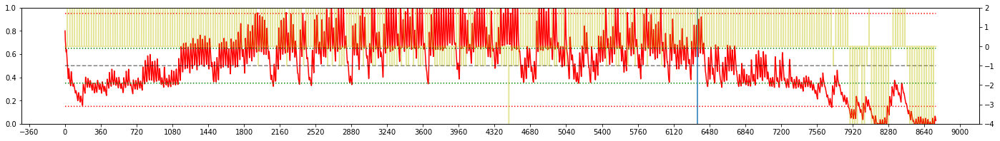


Iteration 87:  WAKKANAI, 2000 
EPSILON = 9.997e-01
LR = 1.406e-05
Average Terminal Reward  =  0.659
Day Violations           =     95
Battery Limit Violations =    306
Action MEAN              =  2.846
Action STD DEV           =  1.952


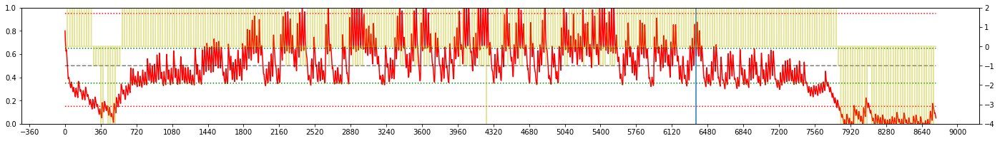


Iteration 88:  WAKKANAI, 2005 
EPSILON = 9.997e-01
LR = 1.402e-05
Average Terminal Reward  =  0.968
Day Violations           =     90
Battery Limit Violations =    200
Action MEAN              =  3.042
Action STD DEV           =  2.162


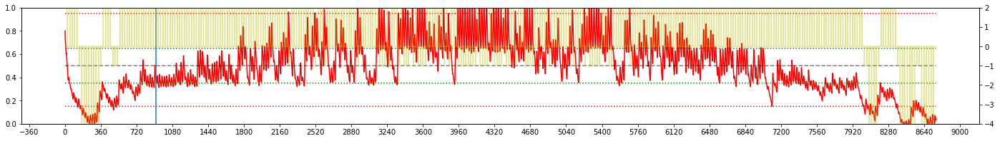


Iteration 89:  WAKKANAI, 2009 
EPSILON = 9.998e-01
LR = 1.398e-05
Average Terminal Reward  =  0.525
Day Violations           =    110
Battery Limit Violations =    220
Action MEAN              =  2.911
Action STD DEV           =  2.113


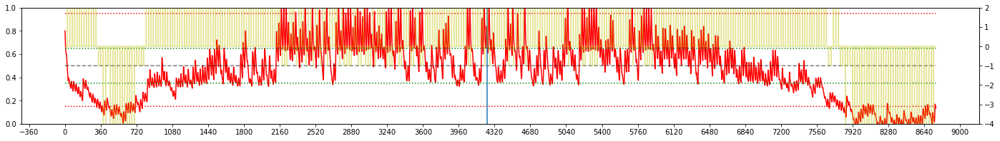


Iteration 90:  WAKKANAI, 2007 
EPSILON = 9.998e-01
LR = 1.396e-05
Average Terminal Reward  =  0.816
Day Violations           =     89
Battery Limit Violations =    340
Action MEAN              =  3.042
Action STD DEV           =  2.147


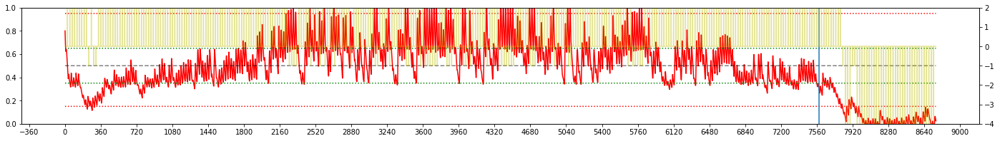


Iteration 91:  WAKKANAI, 2005 
EPSILON = 9.999e-01
LR = 1.393e-05
Average Terminal Reward  =  1.004
Day Violations           =     87
Battery Limit Violations =    179
Action MEAN              =  3.057
Action STD DEV           =  2.238


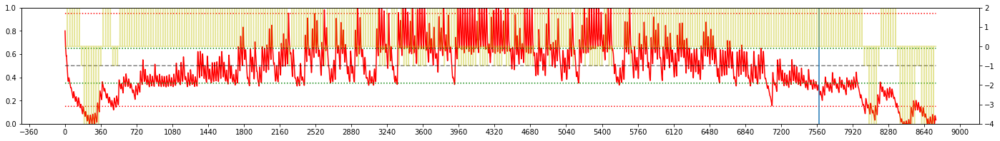


Iteration 92:  WAKKANAI, 2004 
EPSILON = 9.999e-01
LR = 1.391e-05
Average Terminal Reward  =  0.783
Day Violations           =     87
Battery Limit Violations =    361
Action MEAN              =  3.020
Action STD DEV           =  2.212


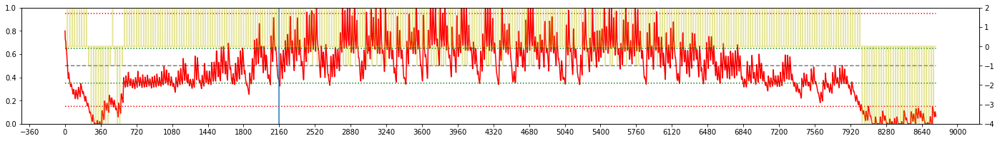


Iteration 93:  WAKKANAI, 2001 
EPSILON = 9.999e-01
LR = 1.390e-05
Average Terminal Reward  =  0.766
Day Violations           =     92
Battery Limit Violations =    377
Action MEAN              =  2.919
Action STD DEV           =  2.199


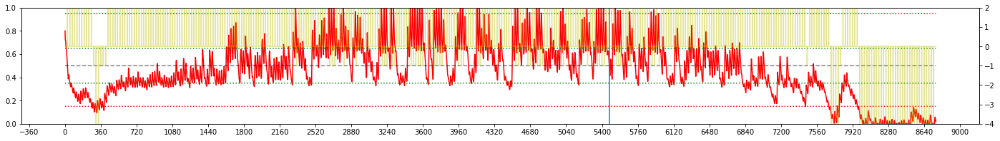


Iteration 94:  WAKKANAI, 2000 
EPSILON = 9.999e-01
LR = 1.388e-05
Average Terminal Reward  =  0.722
Day Violations           =     82
Battery Limit Violations =    416
Action MEAN              =  2.890
Action STD DEV           =  2.054


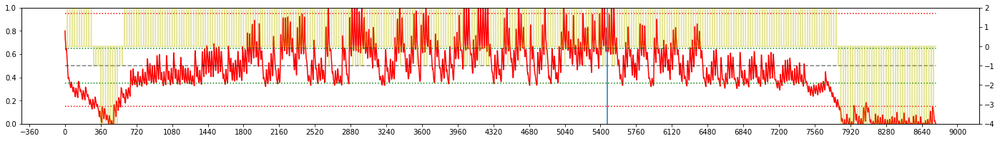


Iteration 95:  WAKKANAI, 2008 
EPSILON = 9.999e-01
LR = 1.387e-05
Average Terminal Reward  =  0.389
Day Violations           =    110
Battery Limit Violations =    472
Action MEAN              =  3.031
Action STD DEV           =  2.379


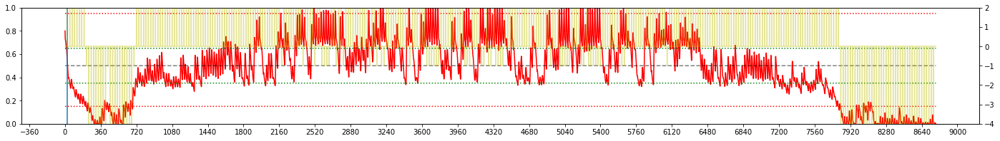


Iteration 96:  WAKKANAI, 2005 
EPSILON = 9.999e-01
LR = 1.386e-05
Average Terminal Reward  =  0.947
Day Violations           =     91
Battery Limit Violations =    219
Action MEAN              =  3.054
Action STD DEV           =  2.446


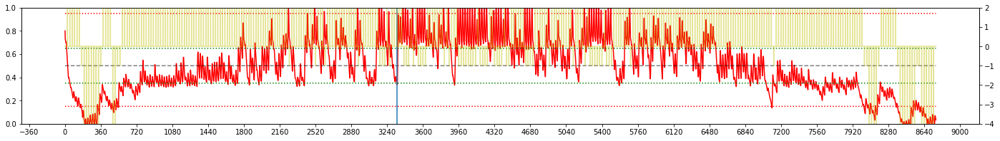


Iteration 97:  WAKKANAI, 2006 
EPSILON = 1.000e+00
LR = 1.385e-05
Average Terminal Reward  =  0.824
Day Violations           =     86
Battery Limit Violations =    326
Action MEAN              =  2.921
Action STD DEV           =  2.195


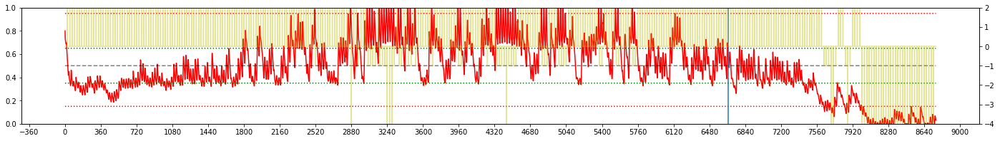


Iteration 98:  WAKKANAI, 2002 
EPSILON = 1.000e+00
LR = 1.384e-05
Average Terminal Reward  =  0.461
Day Violations           =    100
Battery Limit Violations =    485
Action MEAN              =  2.950
Action STD DEV           =  2.101


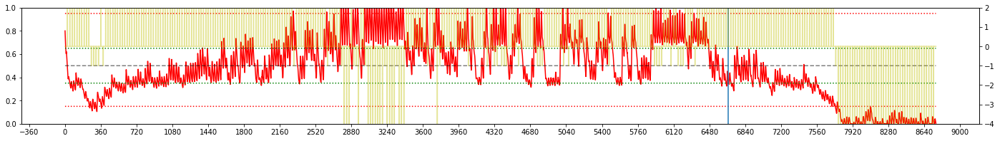


Iteration 99:  WAKKANAI, 2000 
EPSILON = 1.000e+00
LR = 1.383e-05
Average Terminal Reward  =  0.581
Day Violations           =     97
Battery Limit Violations =    513
Action MEAN              =  2.862
Action STD DEV           =  2.218


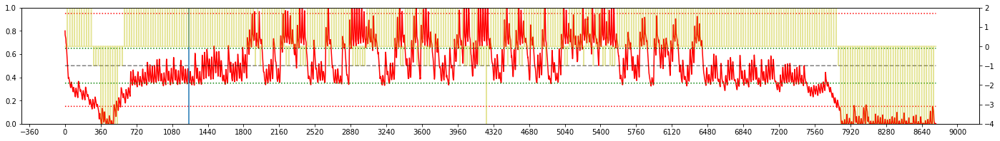

In [17]:
#TRAIN 
dqn = DQN()
# for recording weights
oldfc1 = dqn.eval_net.fc1.weight.data.cpu().numpy().flatten()
old2fc1 = oldfc1

# oldfc2 = dqn.eval_net.fc2.weight.data.cpu().numpy().flatten()
# old2fc2 = oldfc2

# oldfc3 = dqn.eval_net.fc3.weight.data.cpu().numpy().flatten()
# old2fc3 = oldfc3

oldout = dqn.eval_net.fc_out.weight.data.cpu().numpy().flatten()
old2out = oldout
########################################

change_hr = 0 #when dqn target_net is updated by eval_net
avg_reward_rec = [] #record the yearly average rewards over the entire duration of training
batt_violation_rec = []
day_violation_rec = []

print('Device: ', dqn.device)
#TRAINING STARTS
tic = datetime.now()

e_rec = []
lr_rec = []
for iteration in range(NO_OF_ITERATIONS):
    # EPSILON SCHEDULING
    e_slope = 5
    e_start = 0.5
    e_inflection_point = 50
    EPSILON = e_start + (1-e_start)/(1 + np.exp(-(iteration-e_inflection_point)/e_slope))

    # LR SCEHDULING
    lr_slope = 3
    lr_start = 0
    lr_inflection_point = 2
    if iteration <=50:
        lrate =  (lr_start + (1-lr_start)/(1 + np.exp(-(iteration-lr_inflection_point)/lr_slope)))*1e-4
    else:
        lrate = 0.95*(lrate-lrate*0.1)+0.2*1e-5
    dqn.optimizer = torch.optim.Adam(dqn.eval_net.parameters(), lr=lrate)
#     dqn.optimizer = torch.optim.Adam(dqn.eval_net.parameters(), lr=lrate, weight_decay=WT_DECAY))
    lr_rec= np.append(lr_rec,lrate)

    LOCATION    = 'wakkanai'#random.choice(['tokyo','wakkanai','minamidaito'])
    YEAR        = random.choice(np.arange(2000,2010))
    
    capm        = CAPM(LOCATION,YEAR,shuffle=False, trainmode=False) #instantiate the CAPM class
    capm.eno    = ENO(LOCATION,YEAR, shuffle=False, day_balance=False) #instantiate the environment inside the CAPM class
    capm.HMAX   = capm.eno.SMAX #maximum power output of solar cell is set in CAPM object using the value in ENO object


    s, r, day_end, year_end = capm.reset(batt=0.8*capm.BMAX)
    yr_record      = np.empty(4)
    transition_rec = np.zeros((capm.eno.TIME_STEPS, N_STATES * 2 + 2)) #record all the transition in one day

    while True:
        a = dqn.choose_action(stdize(s))
        yr_record = np.vstack((yr_record, [s[0],s[2],r, a]))

        # take action
        s_, r, day_end, year_end = capm.step(a)
        
        temp_transitions                = np.hstack((stdize(s), [a, r], stdize(s_)))
        transition_rec[capm.eno.hr-1,:] = temp_transitions

        if (day_end):
            transition_rec[:,5]  = r #broadcast reward to all states
            decay_factor         = [i for i in (LAMBDA**n for n in reversed(range(0, capm.eno.TIME_STEPS)))]
            transition_rec[:,5]  = transition_rec[:,5] * decay_factor #decay reward proportionately
            dqn.store_day_transition(transition_rec)

        if dqn.good_memory_counter > MEMORY_CAPACITY and dqn.bad_memory_counter > MEMORY_CAPACITY:
            dqn.learn()

        if dqn.nettoggle:
            change_hr = capm.eno.day*24+capm.eno.hr #to mark when the DQN is updated.
            dqn.nettoggle = not dqn.nettoggle

        if (year_end):
            break

        # transition to new state
        s = s_

    yr_record = np.delete(yr_record, 0, 0)     #remove the first row which is garbage
    hourly_yr_reward_rec = yr_record[:,2]      #extract reward information from the record array
    yr_reward_rec = hourly_yr_reward_rec[::24] #only consider terminal rewards

    print('\nIteration {}:  {}, {} '.format(iteration, LOCATION.upper(), YEAR))
    print('EPSILON = {:6.3e}'.format(EPSILON))
    for param_group in dqn.optimizer.param_groups:
        print('LR = {:6.3e}'.format(param_group['lr']))
    print("Average Terminal Reward  = {:6.3f}".format(np.mean(yr_reward_rec)))
    print("Day Violations           = {:6d}".format(capm.violation_counter))
    print("Battery Limit Violations = {:6d}".format(capm.batt_violations))
    print("Action MEAN              = {:6.3f}".format(np.mean(yr_record[:,-1] + 1)))
    print("Action STD DEV           = {:6.3f}".format(np.std(yr_record[:,-1] + 1)))
   
    # Log the average reward in avg_reward_rec to plot later in the learning curve graph figure
    avg_reward_rec      = np.append(avg_reward_rec, np.mean(yr_reward_rec))
    day_violation_rec   = np.append(day_violation_rec, capm.violation_counter)
    batt_violation_rec  = np.append(batt_violation_rec, capm.batt_violations)

###########################################################################################
###########################################################################################
#   PLOT battery levels, hourly rewards and the weights
    
    #PLOT BATTERY AND REWARD
    fig = plt.figure(figsize=(24,3))
    TIME_STEPS = capm.eno.TIME_STEPS
    NO_OF_DAYS = capm.eno.NO_OF_DAYS
    DAY_SPACING = 15
    TICK_SPACING = TIME_STEPS*DAY_SPACING
    
    #plot battery
    ax = fig.add_subplot(111)
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS),  yr_record[:,0],'r')
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*capm.BOPT/capm.BMAX, 'k--', alpha=0.5)
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*capm.BLIM_LO/capm.BMAX, 'r:')
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*capm.BLIM_HI/capm.BMAX, 'r:')
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*(capm.BOPT+capm.ENP_MARGIN /2) /capm.BMAX, 'g:')
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*(capm.BOPT-capm.ENP_MARGIN/2)/capm.BMAX, 'g:')
    ax.set_ylim([0,1])
    ax.axvline(x=change_hr)
    ax.xaxis.set_major_locator(ticker.MultipleLocator(TICK_SPACING))

    #plot hourly reward
    ax0 = ax.twinx()
    ax0.plot(hourly_yr_reward_rec, color='y',alpha=0.4)
    ax0.set_ylim(-4,2)
    
    plt.show()
# # #################################################################
#     # PLOT WEIGHTS
#     fig = plt.figure(figsize=(18,6))

#     ax1 = fig.add_subplot(211)
#     newfc1 = dqn.eval_net.fc1.weight.data.cpu().numpy().flatten()
#     xaxis = np.arange(0,newfc1.shape[0])
#     ax1.bar(xaxis, old2fc1, color='b', alpha = 0.3)
#     ax1.bar(xaxis, oldfc1,  color='b', alpha = 0.5)
#     ax1.bar(xaxis, newfc1,  color='b', alpha = 1.0)
#     ax1.set_title("FC1")
# #     ax1.set_ylim([-4,4])
#     ax1.set_ylabel("Weight Value")

#     axO = fig.add_subplot(212)
#     newout = dqn.eval_net.fc_out.weight.data.cpu().numpy().flatten()
#     xaxis = np.arange(0,newout.shape[0])
#     axO.bar(xaxis, old2out, color='g', alpha = 0.3)
#     axO.bar(xaxis, oldout,  color='g', alpha = 0.5)
#     axO.bar(xaxis, newout,  color='g', alpha = 1.0)
#     axO.set_title("FC OUT")
# #     axO.set_ylim([-4,4])
#     axO.set_ylabel("Weight Value")

#     fig.tight_layout()
#     plt.show()
# # #################################################################

#     # PLOT HISTOGRAM OF WEIGHTS
#     fig = plt.figure(figsize=(18,6))

#     ax1 = fig.add_subplot(211)
#     newfc1 = dqn.eval_net.fc1.weight.data.cpu().numpy().flatten()
#     xaxis = np.arange(0,newfc1.shape[0])
# #     ax1.hist(old2fc1, density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='b' , alpha = 0.1 )
# #     ax1.hist(oldfc1,  density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='b' , alpha = 0.3 )
#     ax1.hist(newfc1,  density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='b' , alpha = 0.6 )
#     ax1.set_title("FC1")
#     ax1.set_xlabel("Weight Value")


#     axO = fig.add_subplot(212)
#     newout = dqn.eval_net.fc_out.weight.data.cpu().numpy().flatten()
#     xaxis = np.arange(0,newout.shape[0])
# #     axO.hist(old2out, density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='g' , alpha = 0.1)
# #     axO.hist(oldout,  density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='g' , alpha = 0.3)
#     axO.hist(newout,  density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='g' , alpha = 0.6)
#     axO.set_title("FC OUT")
#     axO.set_xlabel("Weight Value")


#     fig.tight_layout()
#     plt.show()
# # #################################################################    
    
#     old2fc1 = oldfc1
#     oldfc1 = newfc1
    
#     old2out = oldout
#     oldout = newout

    # End of training

In [18]:
print('Train time: {}\n'.format(datetime.now() - tic))
torch.save(dqn.eval_net.state_dict(), './models/'+ 'demo_' + MODELNAME)

Train time: 0:09:46.225966



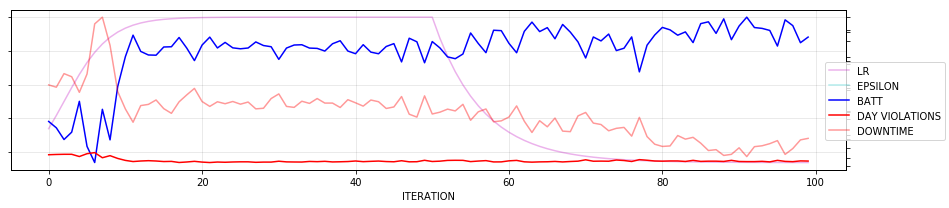

In [19]:
###########################################################################################
###########################################################################################

#PLOT LR AND EPSILON SCHEDULING
fig = plt.figure(figsize=(12,3))
ax = fig.add_subplot(111)
# ax.set_title("LR and EPSILON SCHEDULING V3")
ax.set_xlabel("ITERATION")
# ax.set_ylabel("LR",      color = 'm')
ax.plot(lr_rec,          color = 'm', alpha = 0.3,label="LR")
# ax.tick_params(axis='y', color = 'm')
# ax.ticklabel_format(style='sci', axis='y', scilimits=(-6,-7))
# ax.minorticks_on()

# ax.set_axisbelow(True)
ax.yaxis.set_ticklabels([])

ax.grid(b=True, which='minor', linestyle=':',  color='k', alpha = 0.1)
ax.grid(b=True, which='major', linestyle='-',  color='k', alpha = 0.1)

ax_ = ax.twinx()
# ax_.set_ylabel("EPSILON", color = 'c')
# ax_.tick_params(axis='y', color = 'c')
# ax_.set_axisbelow(True)
# ax_.minorticks_on()
ax_.plot(e_rec,           color = 'c', alpha = 0.3, label="EPSILON")
ax_.yaxis.set_ticklabels([])

# Plot the average reward log
ax1 = ax.twinx()
# ax1.set_ylabel("Terminal Reward", color = 'b')
# ax1.set_ylim([-10,2]);
ax1.plot(avg_reward_rec,'b',label="BATT")
# ax1.tick_params(axis='y', colors='b')
ax1.yaxis.set_ticklabels([])

# Plot the violation record log
ax2 = ax.twinx()
# ax2.set_ylabel("Violations",color = 'r')
ax2.plot(day_violation_rec,'r', label="DAY VIOLATIONS")
ax2.plot(batt_violation_rec,'r',alpha=0.4, label="DOWNTIME")
for xpt in np.argwhere(batt_violation_rec<1):
    ax2.axvline(x=xpt,color='g',linewidth='0.5')
# ax2.set_ylim([0,50]);
# ax2.tick_params(axis='y', colors='r')
ax2.yaxis.set_ticklabels([])

fig.legend(bbox_to_anchor=(1.1, 0.7))


fig.tight_layout()

###########################################################################################
###########################################################################################

In [20]:
# print("ITERATION #0 :  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[0],e_rec[0]))
# print("ITERATION #10:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[10],e_rec[10]))
# print("ITERATION #20:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[20],e_rec[20]))
# print("ITERATION #50:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[50],e_rec[50]))
# print("ITERATION #80:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[80],e_rec[80]))
# print("ITERATION #99:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[99],e_rec[99]))

In [21]:
S_FILENAME = './models/'+ 'demo_'+ MODELNAME
# S_FILENAME = './models/'+ MODELNAME
print("Loading MODEL from FILE: ", S_FILENAME)
dqn = DQN()
dqn.eval_net.load_state_dict(torch.load(S_FILENAME))
dqn.eval_net.eval()
print("DEVICE: ", dqn.device)

Loading MODEL from FILE:  ./models/demo_B1_2_wakkanai_alt_100w_314.pt
DEVICE:  cpu


***MEASURING PERFORMANCE OF THE MODEL***


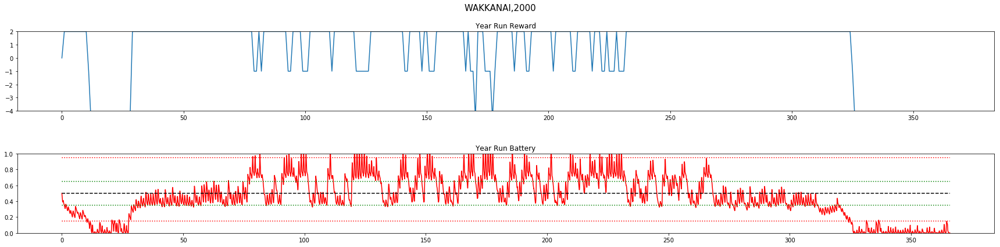

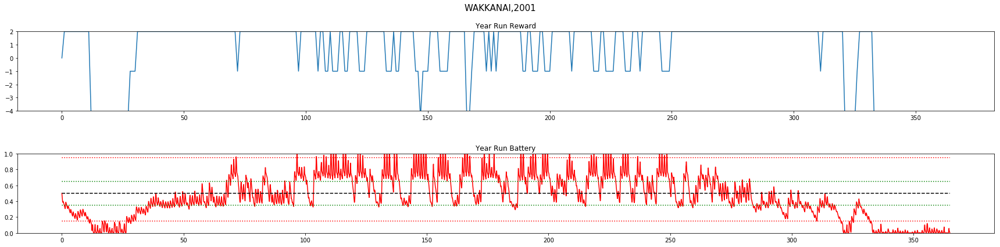

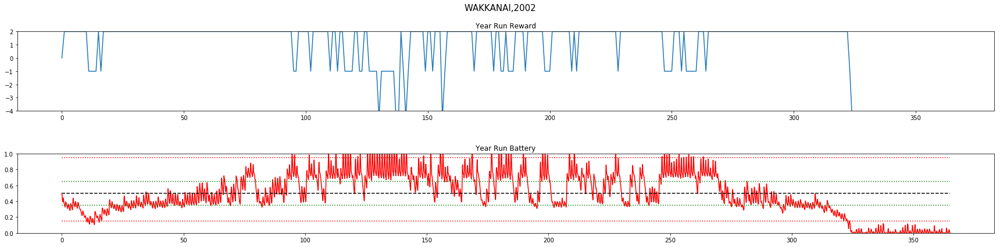

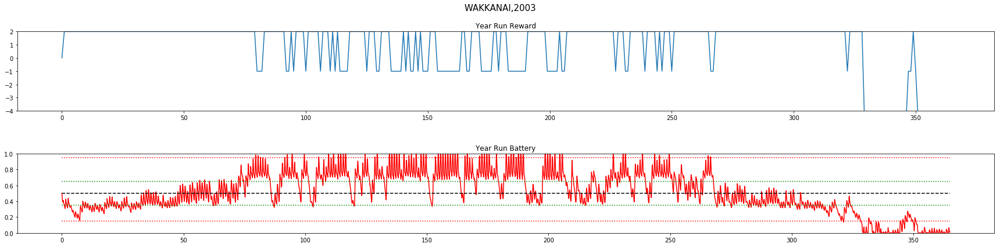

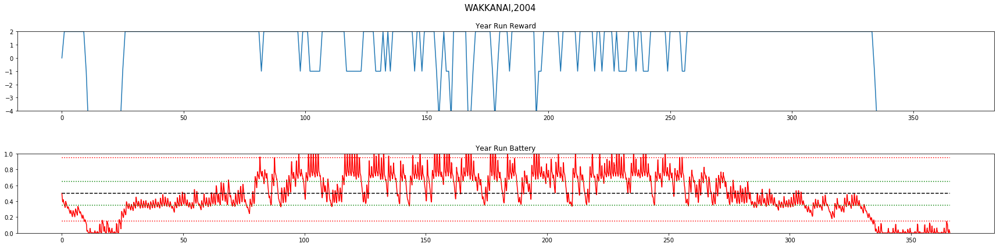

...

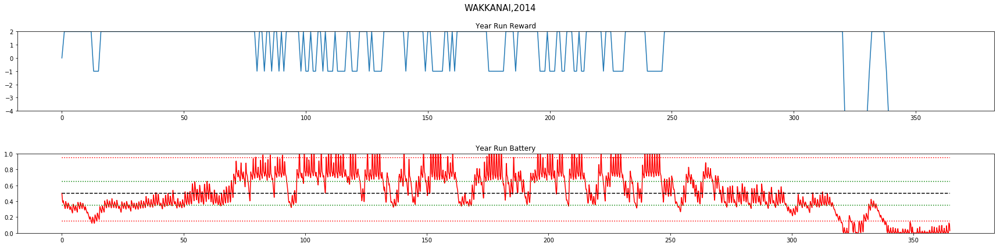

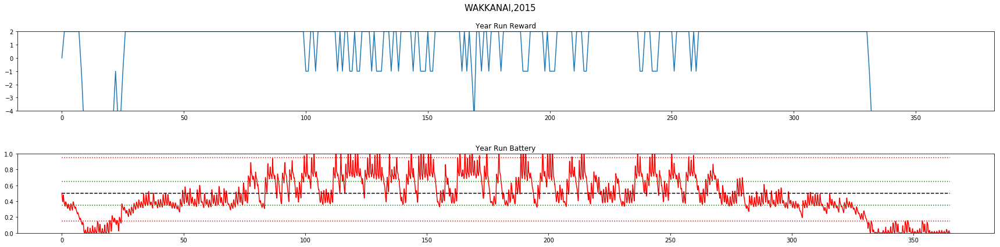

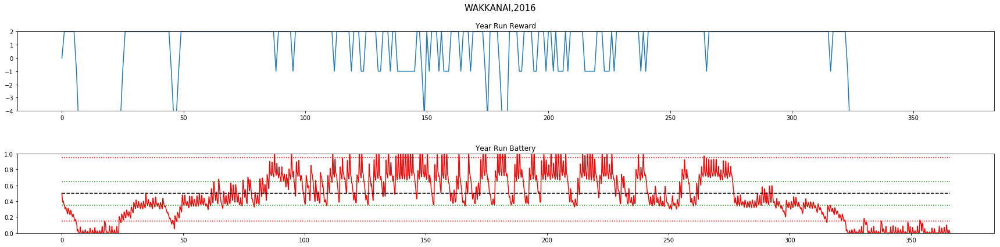

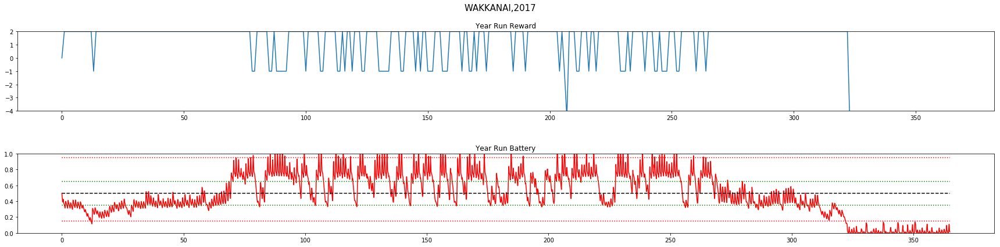

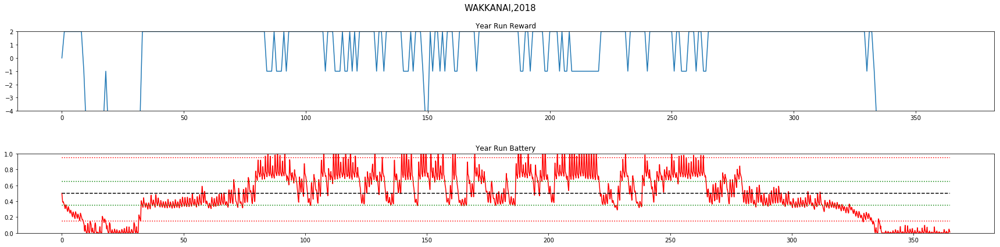



WAKKANAI
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 0.39		105	 577
2001	 0.34		117	 597
2002	 0.56		104	 592
2003	 0.71		108	 446
2004	 0.53		102	 609
2005	 0.57		107	 487
2006	 0.59		99	 531
2007	 0.64		100	 538
2008	 0.15		126	 637
2009	 0.21		122	 634
2010	 0.73		91	 501
2011	 0.65		93	 534
2012	 0.69		92	 602
2013	 0.44		107	 611
2014	 0.64		110	 461
2015	 0.57		99	 487
2016	 0.15		123	 716
2017	 0.58		105	 553
2018	 0.34		117	 636

TOTAL Day Violations:   2027.0
TOTAL Batt Violations:  10749.0
************************************


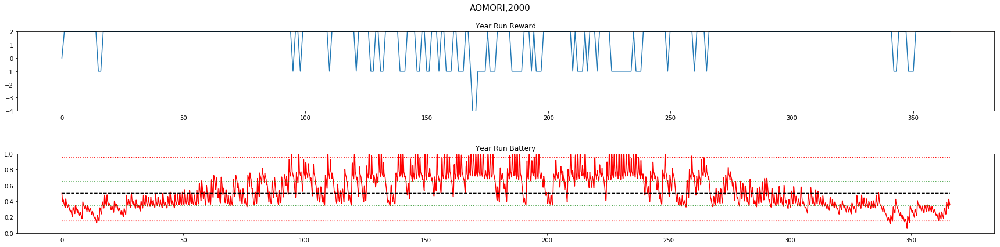

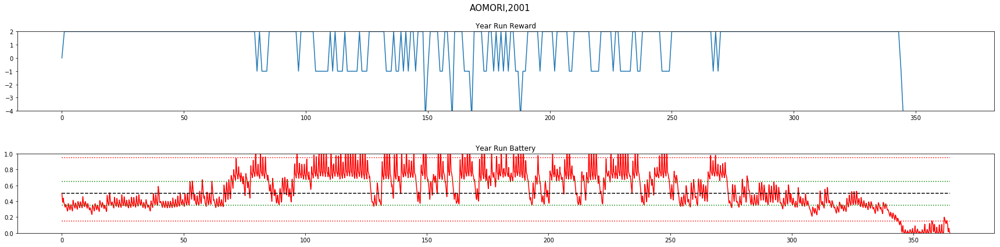

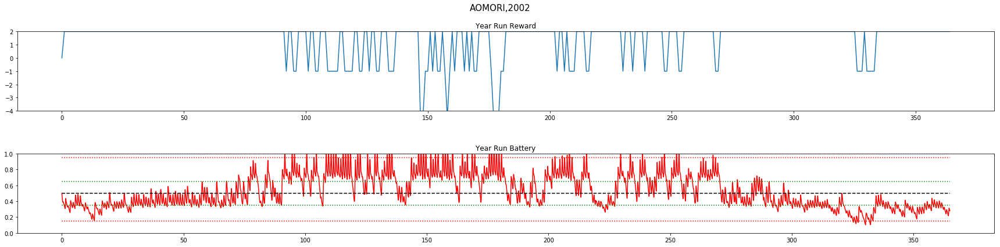

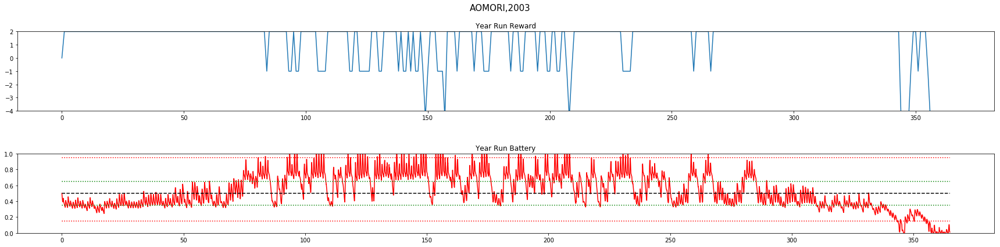

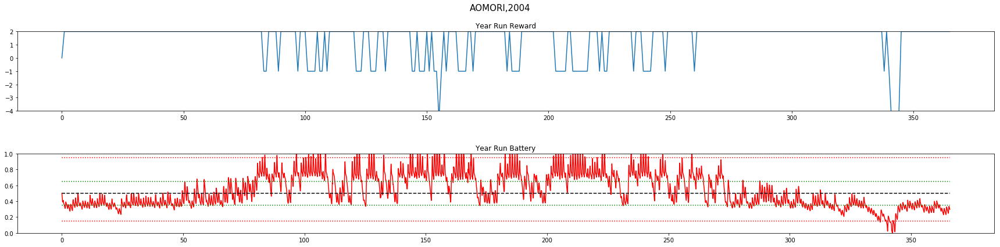

...

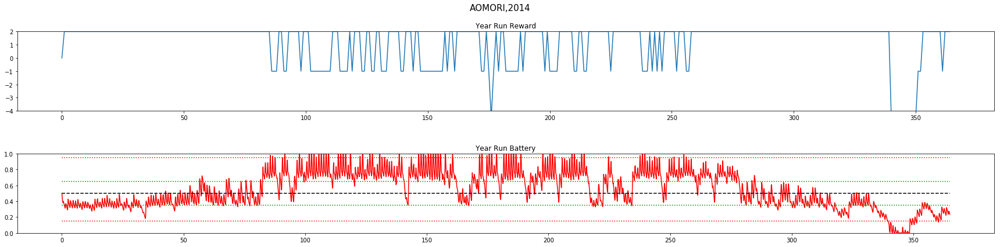

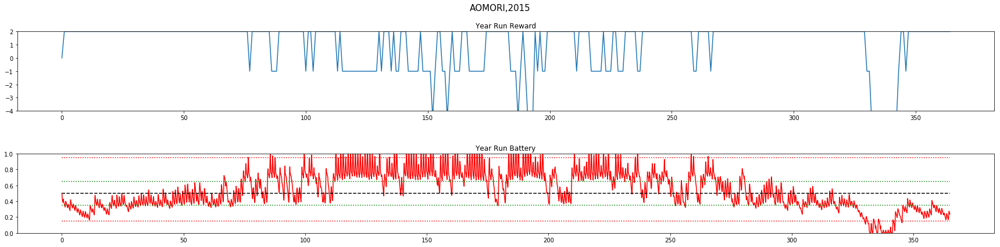

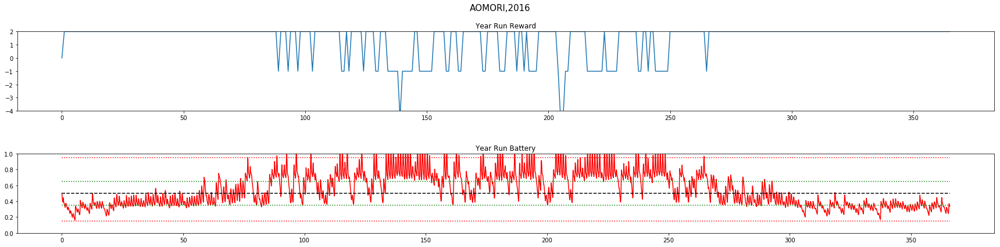

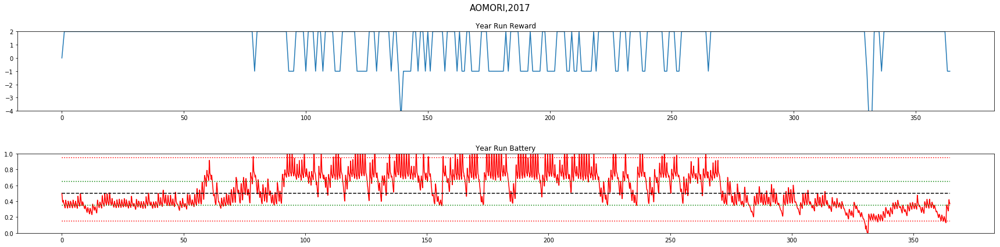

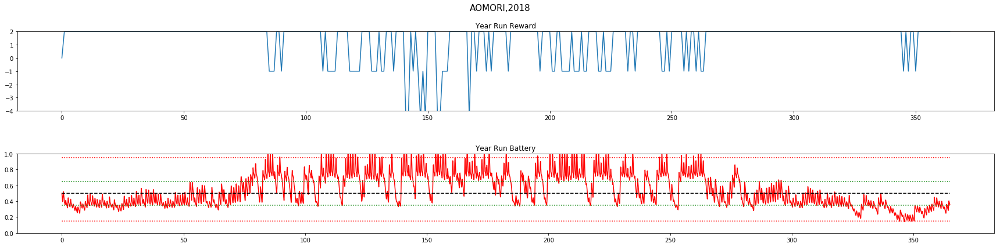



AOMORI
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 1.41		69	 160
2001	 0.92		96	 322
2002	 1.39		67	 145
2003	 1.24		70	 202
2004	 1.39		67	 134
2005	 1.47		61	 143
2006	 1.11		84	 212
2007	 1.25		81	 210
2008	 1.37		73	 189
2009	 1.17		79	 251
2010	 1.25		71	 195
2011	 0.91		93	 329
2012	 0.92		101	 275
2013	 1.46		61	 139
2014	 1.13		88	 250
2015	 1.02		95	 272
2016	 1.4		69	 192
2017	 1.3		80	 211
2018	 1.38		67	 154

TOTAL Day Violations:   1472.0
TOTAL Batt Violations:  3985.0
************************************


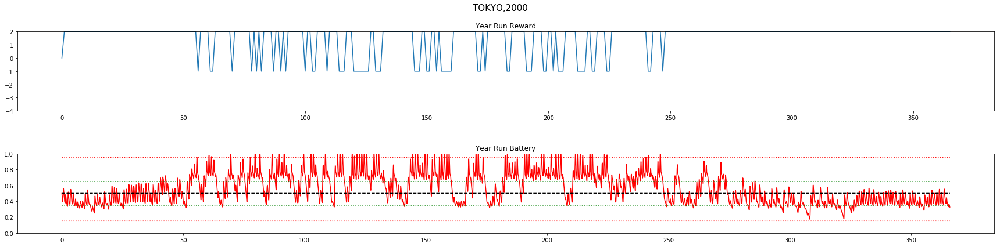

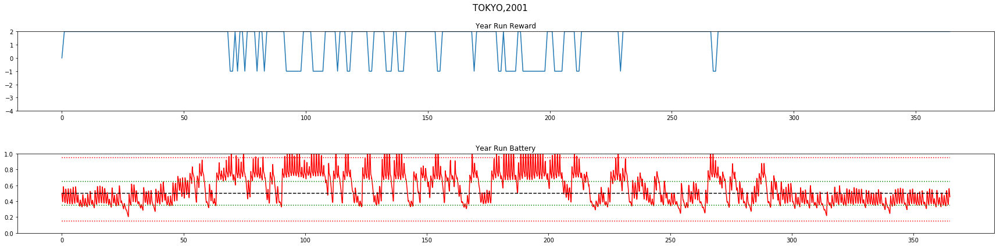

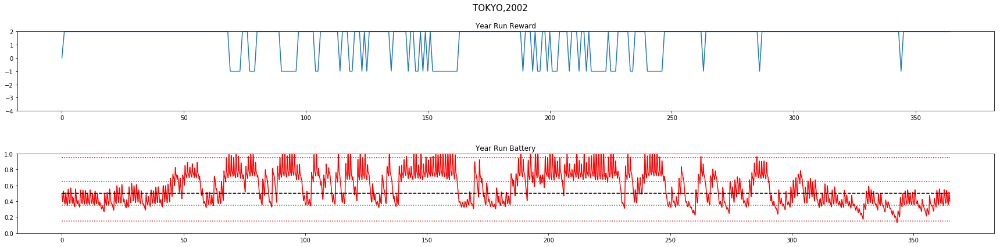

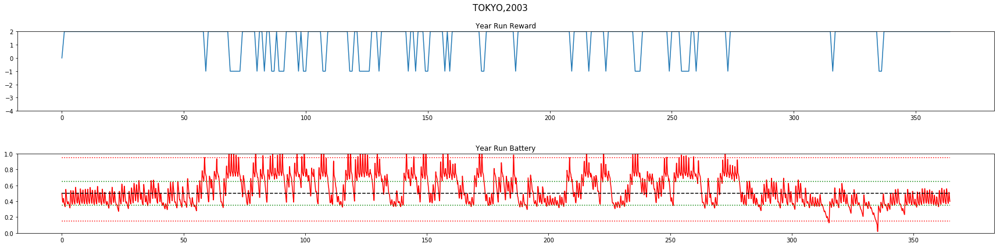

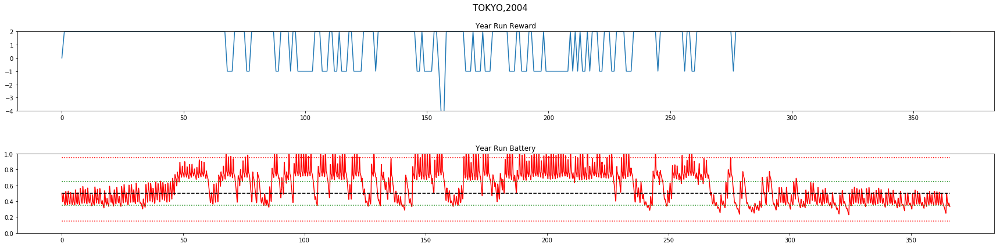

...

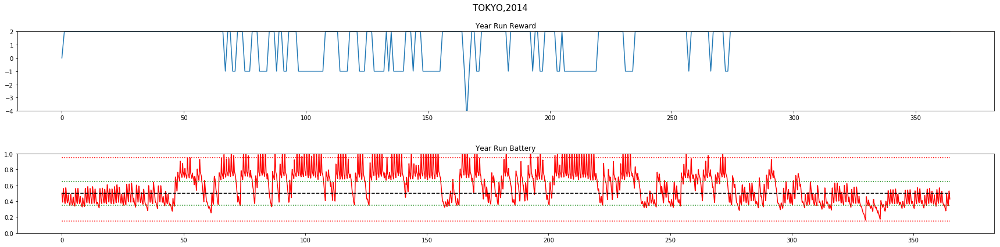

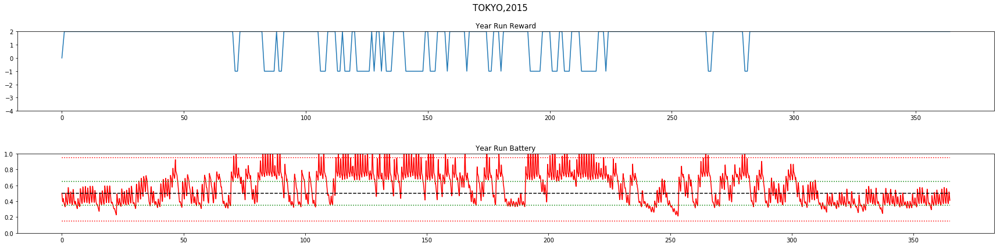

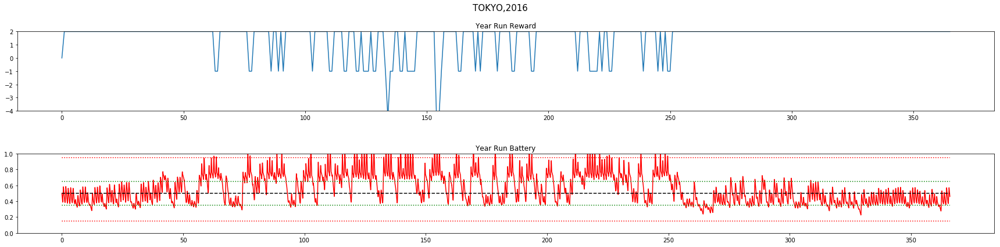

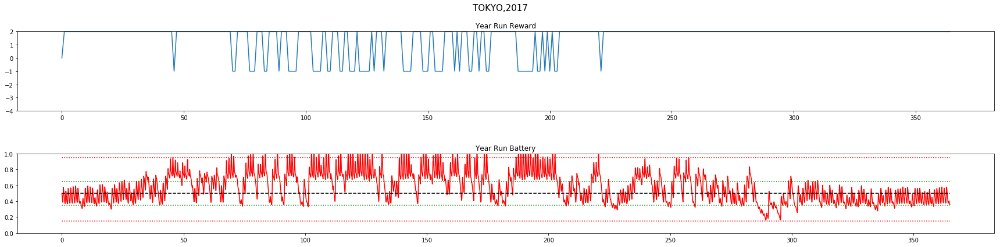

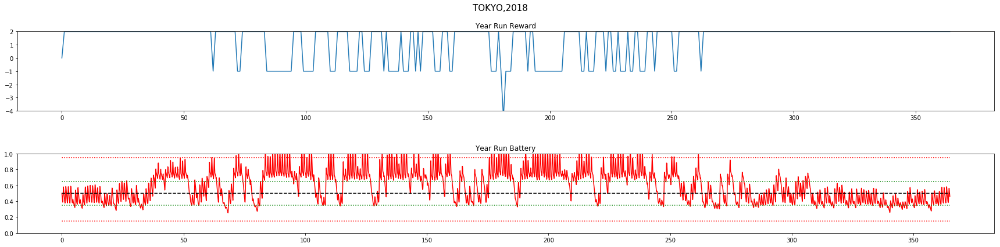



TOKYO
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 1.48		63	 140
2001	 1.52		58	 136
2002	 1.4		72	 135
2003	 1.58		51	 70
2004	 1.29		83	 174
2005	 1.51		59	 102
2006	 1.73		32	 74
2007	 1.43		66	 151
2008	 1.54		56	 80
2009	 1.58		50	 107
2010	 1.41		70	 176
2011	 1.36		76	 168
2012	 1.31		83	 174
2013	 1.23		93	 210
2014	 1.29		84	 219
2015	 1.44		67	 162
2016	 1.52		54	 120
2017	 1.48		63	 163
2018	 1.28		86	 222

TOTAL Day Violations:   1266.0
TOTAL Batt Violations:  2783.0
************************************


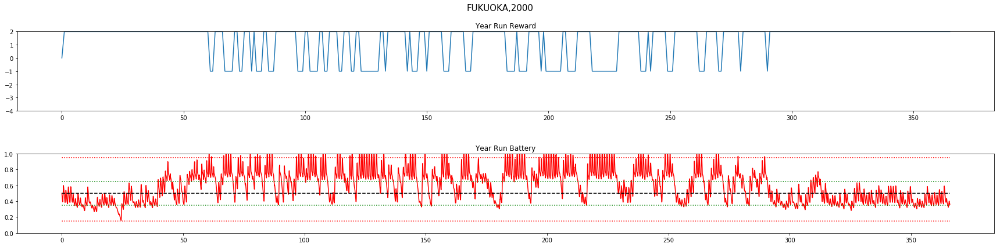

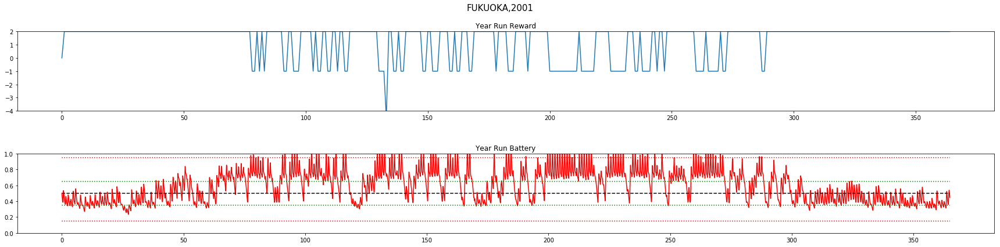

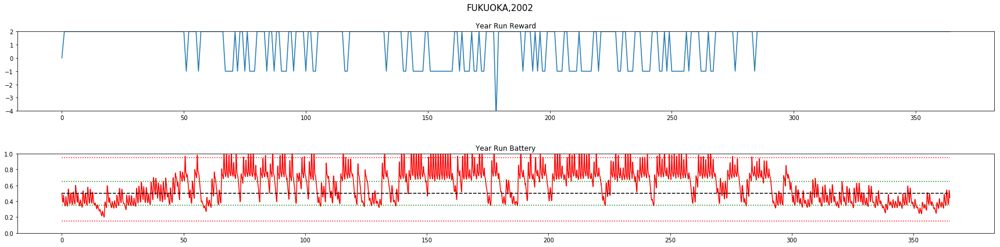

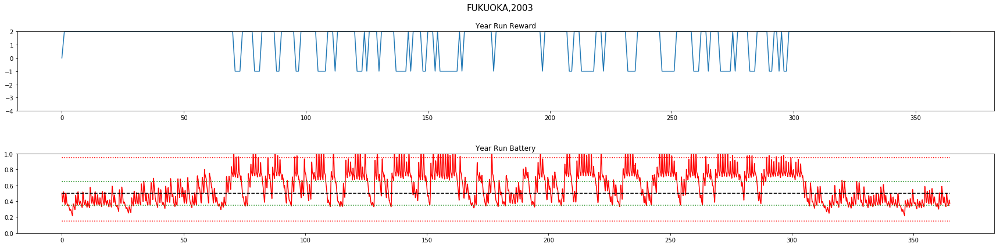

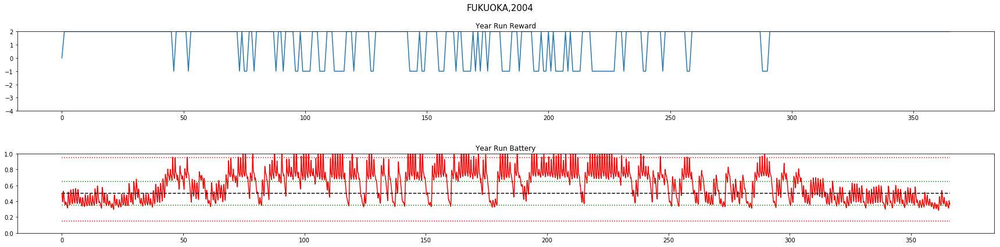

...

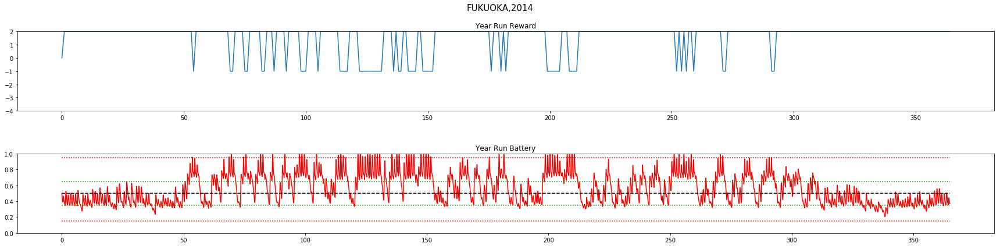

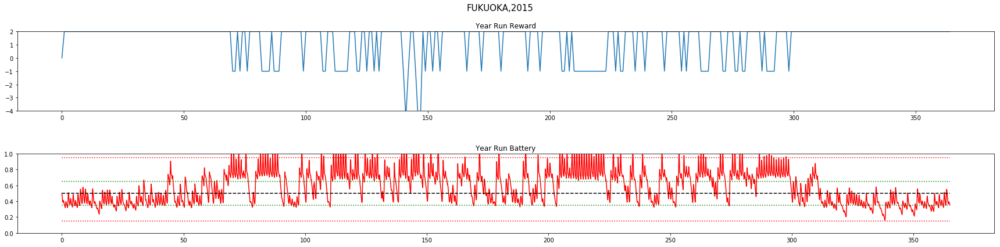

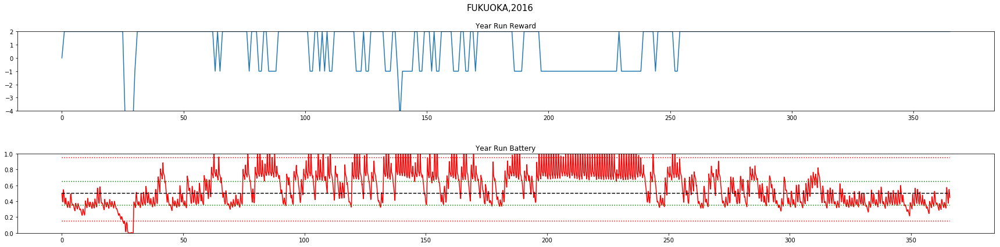

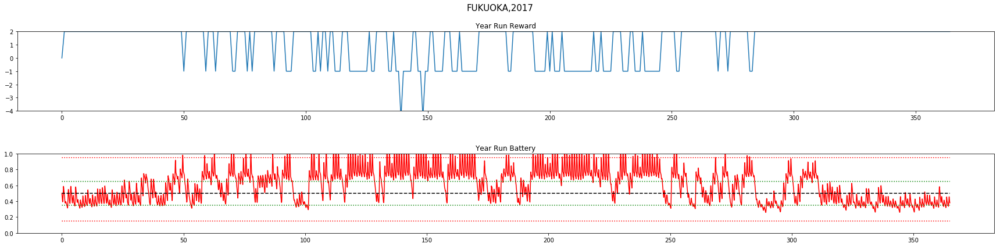

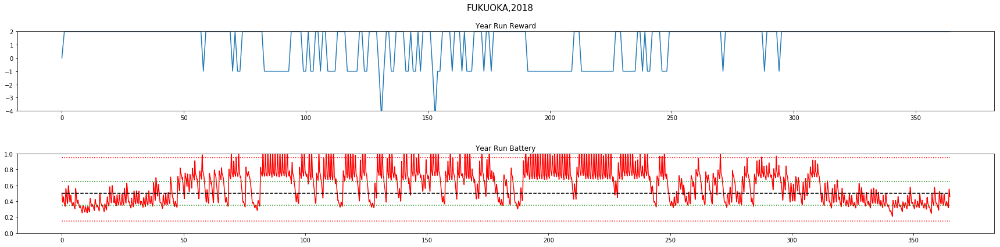



FUKUOKA
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 1.23		93	 238
2001	 1.27		87	 215
2002	 1.22		93	 186
2003	 1.36		77	 154
2004	 1.33		81	 196
2005	 1.25		90	 226
2006	 1.36		77	 191
2007	 1.25		91	 225
2008	 1.29		86	 161
2009	 1.36		77	 214
2010	 1.37		75	 184
2011	 1.44		67	 134
2012	 1.48		63	 134
2013	 1.24		92	 201
2014	 1.5		60	 119
2015	 1.31		80	 208
2016	 1.17		94	 283
2017	 1.12		104	 271
2018	 1.15		100	 289

TOTAL Day Violations:   1587.0
TOTAL Batt Violations:  3829.0
************************************


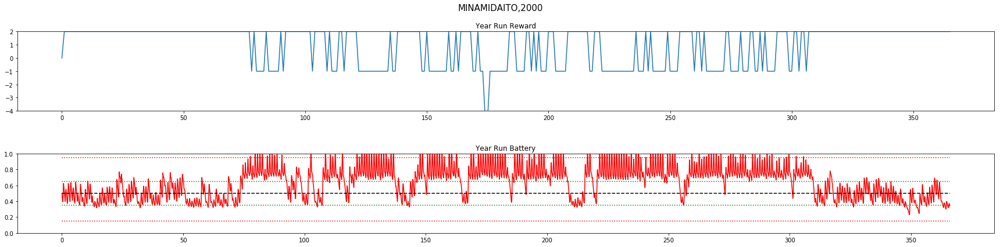

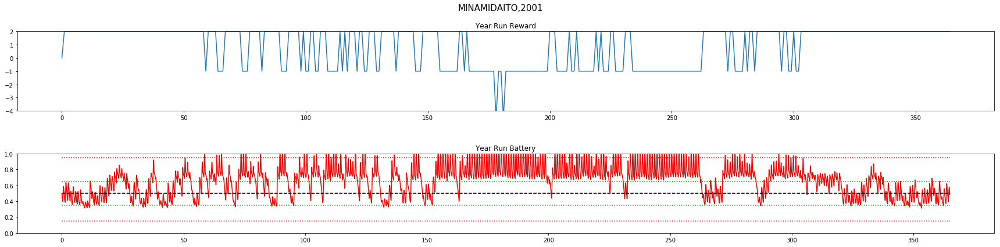

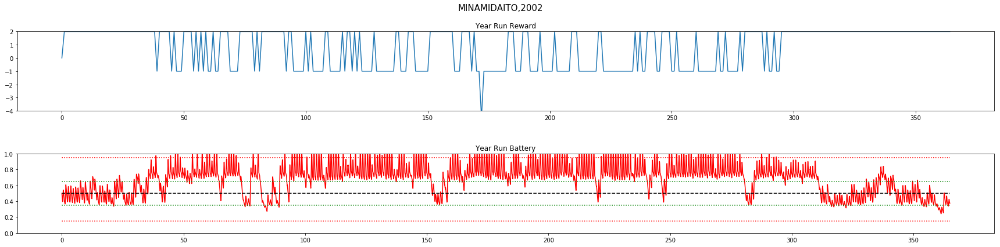

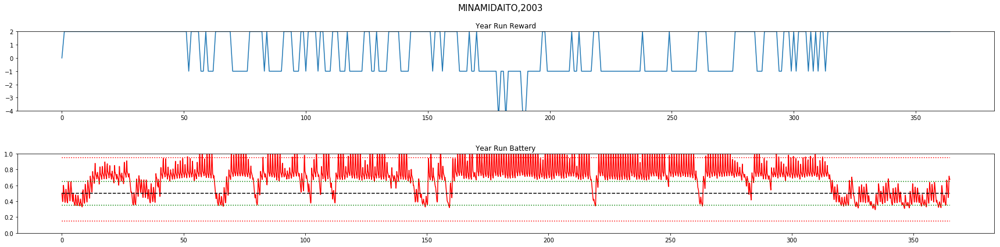

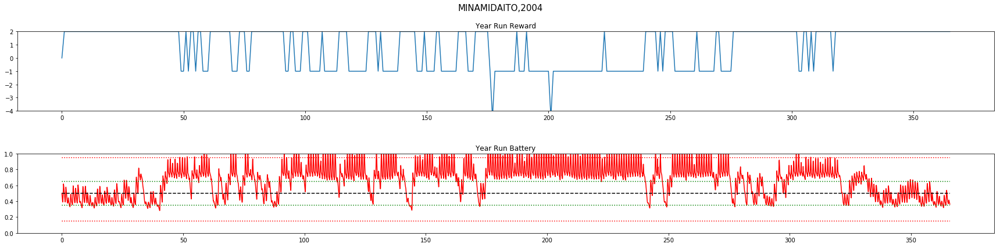

...

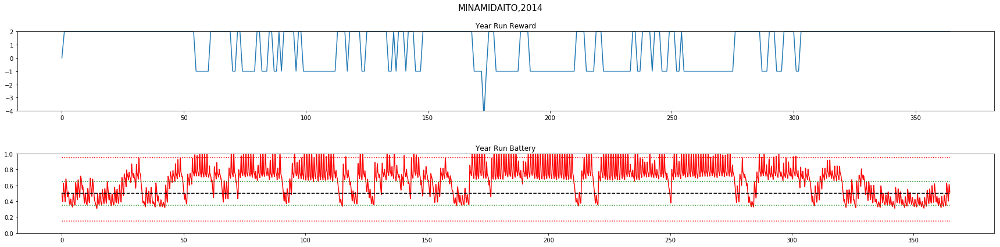

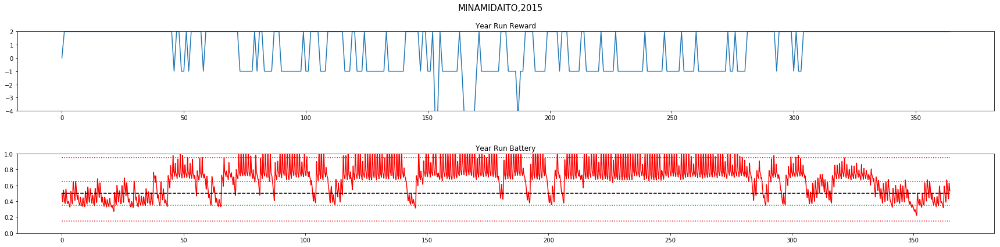

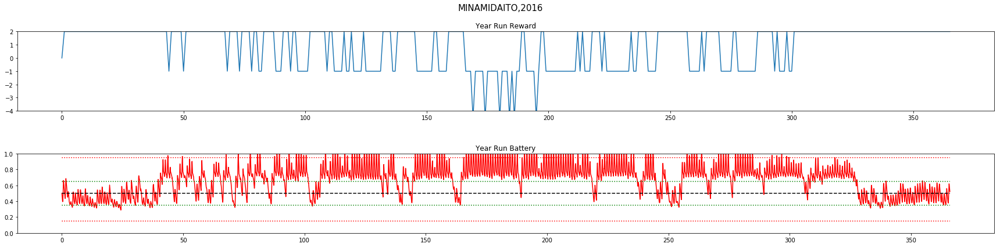

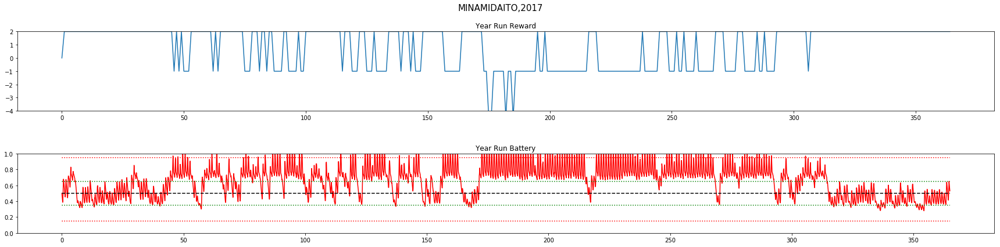

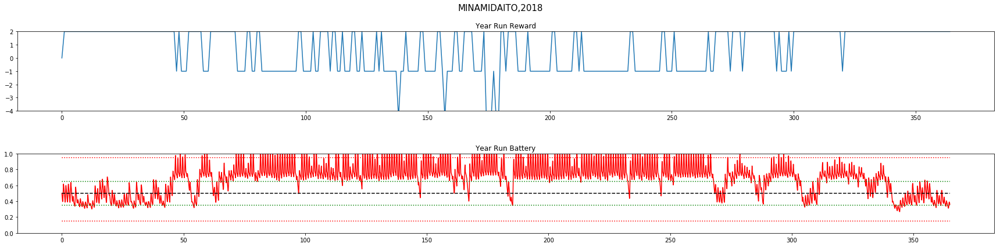



MINAMIDAITO
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 0.9		131	 344
2001	 0.85		137	 378
2002	 0.74		151	 400
2003	 0.66		158	 466
2004	 0.75		150	 391
2005	 0.88		133	 341
2006	 0.69		154	 416
2007	 0.92		124	 332
2008	 0.85		139	 328
2009	 0.67		158	 442
2010	 0.85		135	 345
2011	 0.79		139	 366
2012	 1.05		108	 287
2013	 0.75		148	 379
2014	 0.89		133	 356
2015	 0.62		158	 455
2016	 0.83		135	 392
2017	 0.77		144	 379
2018	 0.6		162	 469

TOTAL Day Violations:   2697.0
TOTAL Batt Violations:  7266.0
************************************


In [22]:
#VALIDATION PHASE
print("***MEASURING PERFORMANCE OF THE MODEL***")
for LOCATION in ['wakkanai','aomori','tokyo','fukuoka','minamidaito']:
    results = np.empty(4)

    for YEAR in np.arange(2000,2019):
        capm      = CAPM(LOCATION,YEAR,shuffle=False, trainmode=False) #instantiate the CAPM class
        capm.eno  = ENO(LOCATION,YEAR, shuffle=False, day_balance=False) #instantiate the environment inside the CAPM class
        capm.HMAX = capm.eno.SMAX #maximum power output of solar cell is set in CAPM object using the value in ENO object

        s, r, day_end, year_end = capm.reset()
        yr_test_record = np.empty(4)

        while True:
            a = dqn.choose_greedy_action(stdize(s))
            yr_test_record = np.vstack((yr_test_record, [s[0],s[2],r, a])) #record battery, henergy, reward and action
            s_, r, day_end, year_end = capm.step(a)
            if year_end:
                break
            s = s_

        yr_test_record = np.delete(yr_test_record, 0, 0) #remove the first row which is garbage
        yr_test_reward_rec = yr_test_record[:,2]
        yr_test_reward_rec = yr_test_reward_rec[::24] #annual average reward
        results = np.vstack((results, [int(YEAR), np.mean(yr_test_reward_rec), int(capm.violation_counter), int(capm.batt_violations)]))

    ###########################################################################################
    ###########################################################################################
        #     Plot the reward and battery for the entire year run
        title = LOCATION.upper() + ',' + str(YEAR)
        NO_OF_DAYS = capm.eno.NO_OF_DAYS

        fig = plt.figure(figsize=(24,6))
        fig.suptitle(title, fontsize=15)

        ax1 = fig.add_subplot(211)
        ax1.plot(yr_test_reward_rec)
        ax1.set_title("\n\nYear Run Reward")
        ax1.set_ylim([-4,2])

        ax2 = fig.add_subplot(212)
        ax2.plot(yr_test_record[:,0],'r')
        ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BOPT/capm.BMAX, 'k--')
        ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BLIM_LO/capm.BMAX, 'r:')
        ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BLIM_HI/capm.BMAX, 'r:')
        ax2.plot(np.ones_like(yr_test_record[:,0])*(capm.BOPT+capm.ENP_MARGIN /2) /capm.BMAX, 'g:')
        ax2.plot(np.ones_like(yr_test_record[:,0])*(capm.BOPT-capm.ENP_MARGIN/2)/capm.BMAX, 'g:')

        ax2.set_title("\n\nYear Run Battery")
        ax2.set_ylim([0,1])
        plt.sca(ax2)
        plt.xticks(np.arange(0, NO_OF_DAYS*24, 50*24),np.arange(0,NO_OF_DAYS,50))
        fig.tight_layout()
        plt.show()
    ###########################################################################################
    ###########################################################################################
    results = np.delete(results,0,0)
    print("\n")
    print(LOCATION.upper())
    print('YEAR\tAVG_RWD\t\tVIOLATIONS')
    print('\t\t\tDAY\tBATT')

    for x in np.arange(0,results.shape[0]):
        print('{}\t {}\t\t{}\t {}'.format(int(results[x,0]), np.around(results[x,1],2), int(results[x,2]), int(results[x,-1])))

    print("\nTOTAL Day Violations:  ",np.sum(results[:, 2]))
    print("TOTAL Batt Violations: ",np.sum(results[:,-1]))
    print("************************************")

In [23]:
print('\nRun time: {}'.format(datetime.now() - tic))


Run time: 0:12:13.673655


In [24]:
LOCATION = 'tokyo'
YEAR = 2000

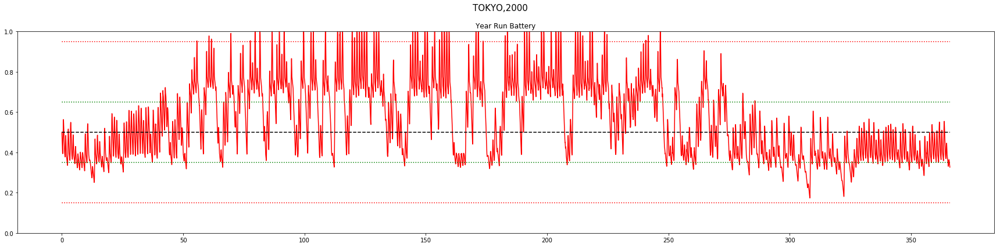

In [25]:
capm = CAPM(LOCATION,YEAR,shuffle=False, trainmode=False) #instantiate the CAPM class
capm.eno = ENO(LOCATION,YEAR, shuffle=False, day_balance=False) #instantiate the environment inside the CAPM class
capm.HMAX = capm.eno.SMAX #maximum power output of solar cell is set in CAPM object using the value in ENO object

s, r, day_end, year_end = capm.reset()
yr_test_record = np.empty(4)

while True:
    a = dqn.choose_greedy_action(stdize(s))

    #state = [batt, enp, henergy, fcast]
    yr_test_record = np.vstack((yr_test_record, [s[0],s[2],r, a])) #record battery, henergy, reward and action

    # take action
    s_, r, day_end, year_end = capm.step(a)

    if year_end:
        break

    s = s_

yr_test_record = np.delete(yr_test_record, 0, 0) #remove the first row which is garbage
yr_test_reward_rec = yr_test_record[:,2]
yr_test_reward_rec = yr_test_reward_rec[::24]

title = LOCATION.upper() + ',' + str(YEAR)
NO_OF_DAYS = capm.eno.NO_OF_DAYS

fig = plt.figure(figsize=(24,6))
fig.suptitle(title, fontsize=15)

#     ax1 = fig.add_subplot(211)
#     ax1.plot(yr_test_reward_rec)
#     ax1.set_title("\n\nYear Run Reward")
#     ax1.set_ylim([-3,3])

#Plot the reward and battery for the entire year run
ax2 = fig.add_subplot(111)
ax2.plot(yr_test_record[:,0],'r')
ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BOPT/capm.BMAX, 'k--')
ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BLIM_LO/capm.BMAX, 'r:')
ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BLIM_HI/capm.BMAX, 'r:')
ax2.plot(np.ones_like(yr_test_record[:,0])*(capm.BOPT+capm.ENP_MARGIN /2) /capm.BMAX, 'g:')
ax2.plot(np.ones_like(yr_test_record[:,0])*(capm.BOPT-capm.ENP_MARGIN/2)/capm.BMAX, 'g:')
ax2.set_title("\n\nYear Run Battery")
ax2.set_ylim([0,1])
plt.sca(ax2)
plt.xticks(np.arange(0, NO_OF_DAYS*24, 50*24),np.arange(0,NO_OF_DAYS,50))
fig.tight_layout()
plt.show()

In [26]:
DAY_START = 320
DAY_END   = 325

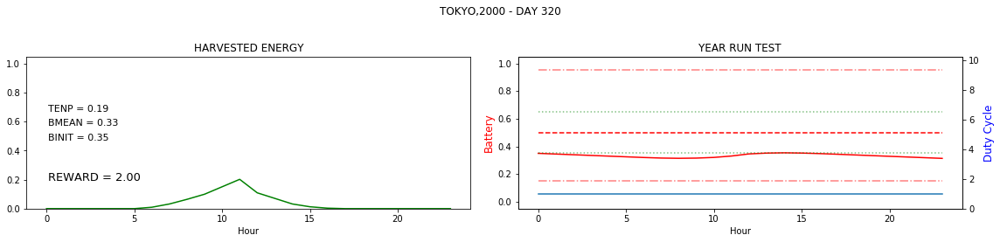

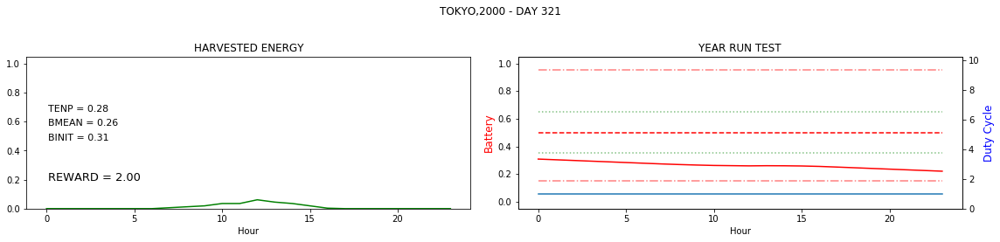

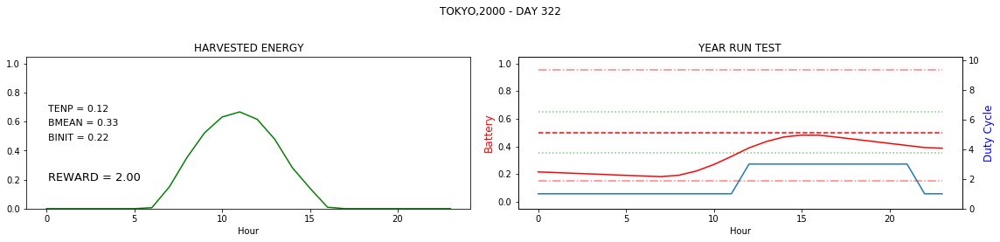

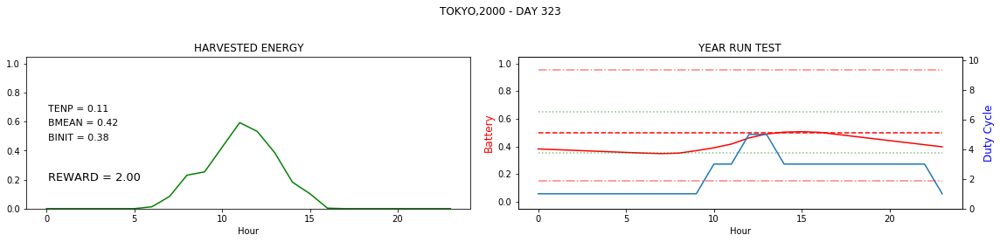

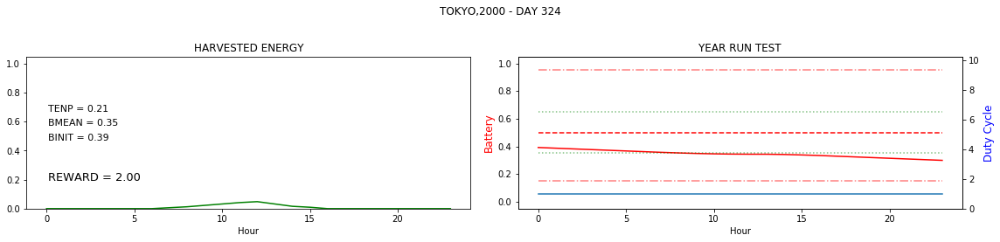

In [27]:
#Plot the reward and battery for the entire year run on a day by day basis
title = LOCATION.upper() + ',' + str(YEAR)
TIME_AXIS = np.arange(0,capm.eno.TIME_STEPS)
for DAY in range(DAY_START,DAY_END):
    START = DAY*24
    END = START+24

    daytitle = title + ' - DAY ' + str(DAY)
    fig = plt.figure(figsize=(16,4))
    st = fig.suptitle(daytitle)

    ax2 = fig.add_subplot(121)
    ax2.plot(yr_test_record[START:END,1],'g')
    ax2.set_title("HARVESTED ENERGY")
    ax2.set_xlabel("Hour")
    ax2.set_ylim([0,1.05])
    
    ax2.text(0.1, 0.6, "TENP = %.2f\n" %(capm.BOPT/capm.BMAX-yr_test_record[END,0]),fontsize=11, ha='left')
    ax2.text(0.1, 0.5, "BMEAN = %.2f\n" %(np.mean(yr_test_record[START:END,0])),fontsize=11, ha='left')
    ax2.text(0.1, 0.4, "BINIT = %.2f\n" %(yr_test_record[START,0]),fontsize=11, ha='left')
    if END < (capm.eno.NO_OF_DAYS*capm.eno.TIME_STEPS):
        ax2.text(0.1, 0.1, "REWARD = %.2f\n" %(yr_test_record[END,2]),fontsize=13, ha='left')
        
    #plot battery for year run
    ax1 = fig.add_subplot(122)
    ax1.plot(TIME_AXIS,              yr_test_record[START:END,0],'r')
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*capm.BOPT/capm.BMAX, 'r--')
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*capm.BLIM_LO/capm.BMAX, 'r-.',alpha=0.5)
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*capm.BLIM_HI/capm.BMAX, 'r-.',alpha=0.5)
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*(capm.BOPT+capm.ENP_MARGIN /2) /capm.BMAX, 'g:',alpha=0.5)
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*(capm.BOPT-capm.ENP_MARGIN/2)/capm.BMAX, 'g:',alpha=0.5)
    
    ax1.set_title("YEAR RUN TEST")
    ax1.set_xlabel("Hour")
    ax1.set_ylabel('Battery', color='r',fontsize=12)
    ax1.set_ylim([-0.05,1.05])

    #plot actions for year run
    ax1a = ax1.twinx()
    ax1a.plot(yr_test_record[START:END,3]+1)
    ax1a.set_ylim([0,N_ACTIONS])
    ax1a.set_ylabel('Duty Cycle', color='b',fontsize=12)
    ax1a.set_ylim([0,10.25])


    fig.tight_layout()
    st.set_y(0.95)
    fig.subplots_adjust(top=0.75)
    plt.show()